# About project

### We need to build a classification model based on the limited dataset for propensity to the product "**Consumer Credit**".
<br>

***Datasets***:<br>
`Clients` -- Clients<br>
`Transactions` -- Transactions<br>
<br>

***Description***:<br>

**Clients**<br>
`client_id` - Client ID<br>
`age` - Age<br>
`gender_code` - Gender<br>
`directory` - City<br>
`aMRG_eop` - Mortgage debt balance<br>
`aCSH_eop` - Consumer loan debt balance<br>
`aCRD_eop` - Credit card debt balance<br>
`pCUR_eop` - Current account balance<br>
`pCRD_eop` - Card account balance<br>
`pSAV_eop` - Savings account balance<br>
`pDEP_eop` - Deposit account balance<br>
`sWork_S` - Monthly salary<br>
`tPOS_S` - POS transaction amount<br>
<br>
**Transactions**<br>
`client_id` - Client ID<br>
`TRANSACTION_DT` - Transaction date<br>
`MCC_KIND_CD` - MCC type<br>
`MCC_CD` - MCC code<br>
`CARD_AMOUNT_EQV_CBR` - Transaction amount in Russian rubles<br>

# Installations

In [ ]:
!pip install PhiK

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 6.2 MB/s eta 0:00:00


In [ ]:
!pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 9.0 MB/s eta 0:00:00


## Service code

In [ ]:
import matplotlib.font_manager as fm
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sn
from matplotlib.collections import QuadMesh


def get_new_fig(fn, figsize=[9, 9]):
    """Init graphics"""
    fig1 = plt.figure(fn, figsize)
    ax1 = fig1.gca()  # Get Current Axis
    ax1.cla()  # clear existing plot
    return fig1, ax1


def configcell_text_and_colors(
    array_df, lin, col, oText, facecolors, posi, fz, fmt, show_null_values=0
):
    """
    config cell text and colors
    and return text elements to add and to dell
    @TODO: use fmt
    """
    text_add = []
    text_del = []
    cell_val = array_df[lin][col]
    tot_all = array_df[-1][-1]
    per = (float(cell_val) / tot_all) * 100
    curr_column = array_df[:, col]
    ccl = len(curr_column)

    # last line  and/or last column
    if (col == (ccl - 1)) or (lin == (ccl - 1)):
        # tots and percents
        if cell_val != 0:
            if (col == ccl - 1) and (lin == ccl - 1):
                tot_rig = 0
                for i in range(array_df.shape[0] - 1):
                    tot_rig += array_df[i][i]
                per_ok = (float(tot_rig) / cell_val) * 100
            elif col == ccl - 1:
                tot_rig = array_df[lin][lin]
                per_ok = (float(tot_rig) / cell_val) * 100
            elif lin == ccl - 1:
                tot_rig = array_df[col][col]
                per_ok = (float(tot_rig) / cell_val) * 100
            per_err = 100 - per_ok
        else:
            per_ok = per_err = 0

        per_ok_s = ["%.2f%%" % (per_ok), "100%"][per_ok == 100]

        # text to DEL
        text_del.append(oText)

        # text to ADD
        font_prop = fm.FontProperties(weight="bold", size=fz)
        text_kwargs = dict(
            color="w",
            ha="center",
            va="center",
            gid="sum",
            fontproperties=font_prop,
        )
        lis_txt = ["%d" % (cell_val), per_ok_s, "%.2f%%" % (per_err)]
        lis_kwa = [text_kwargs]
        dic = text_kwargs.copy()
        dic["color"] = "g"
        lis_kwa.append(dic)
        dic = text_kwargs.copy()
        dic["color"] = "r"
        lis_kwa.append(dic)
        lis_pos = [
            (oText._x, oText._y - 0.3),
            (oText._x, oText._y),
            (oText._x, oText._y + 0.3),
        ]
        for i in range(len(lis_txt)):
            newText = dict(
                x=lis_pos[i][0],
                y=lis_pos[i][1],
                text=lis_txt[i],
                kw=lis_kwa[i],
            )
            text_add.append(newText)

        # set background color for sum cells (last line and last column)
        carr = [0.27, 0.30, 0.27, 1.0]
        if (col == ccl - 1) and (lin == ccl - 1):
            carr = [0.17, 0.20, 0.17, 1.0]
        facecolors[posi] = carr

    else:
        if per > 0:
            txt = "%s\n%.2f%%" % (cell_val, per)
        else:
            if show_null_values == 0:
                txt = ""
            elif show_null_values == 1:
                txt = "0"
            else:
                txt = "0\n0.0%"
        oText.set_text(txt)

        # main diagonal
        if col == lin:
            # set color of the textin the diagonal to white
            oText.set_color("w")
            # set background color in the diagonal to blue
            facecolors[posi] = [0.35, 0.8, 0.55, 1.0]
        else:
            oText.set_color("r")

    return text_add, text_del


def insert_totals(df_cm):
    """insert total column and line (the last ones)"""
    sum_col = []
    for c in df_cm.columns:
        sum_col.append(df_cm[c].sum())
    sum_lin = []
    for item_line in df_cm.iterrows():
        sum_lin.append(item_line[1].sum())
    df_cm["sum_lin"] = sum_lin
    sum_col.append(np.sum(sum_lin))
    df_cm.loc["sum_col"] = sum_col

def pp_matrix(
    df_cm,
    annot=True,
    cmap="Oranges",
    fmt=".2f",
    fz=11,
    lw=0.5,
    cbar=False,
    figsize=[8, 8],
    show_null_values=0,
    pred_val_axis="y",
    title="Confusion Matrix"
):
    """
    print conf matrix with default layout (like matlab)
    params:
      df_cm          dataframe (pandas) without totals
      annot          print text in each cell
      cmap           Oranges,Oranges_r,YlGnBu,Blues,RdBu, ... see:
      fz             fontsize
      lw             linewidth
      pred_val_axis  where to show the prediction values (x or y axis)
                      'col' or 'x': show predicted values in columns (x axis) instead lines
                      'lin' or 'y': show predicted values in lines   (y axis)
    """
    if pred_val_axis in ("col", "x"):
        xlbl = "Predicted"
        ylbl = "Actual"
    else:
        xlbl = "Actual"
        ylbl = "Predicted"
        df_cm = df_cm.T

    # create "Total" column
    insert_totals(df_cm)

    # this is for print allways in the same window
    fig, ax1 = get_new_fig("Conf matrix default", figsize)

    ax = sn.heatmap(
        df_cm,
        annot=annot,
        annot_kws={"size": fz},
        linewidths=lw,
        ax=ax1,
        cbar=cbar,
        cmap=cmap,
        linecolor="w",
        fmt=fmt,
    )

    # set ticklabels rotation
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=10)
    ax.set_yticklabels(ax.get_yticklabels(), rotation=25, fontsize=10)

    # Turn off all the ticks
    for t in ax.xaxis.get_major_ticks():
        t.tick1On = False
        t.tick2On = False
    for t in ax.yaxis.get_major_ticks():
        t.tick1On = False
        t.tick2On = False

    # face colors list
    quadmesh = ax.findobj(QuadMesh)[0]
    facecolors = quadmesh.get_facecolors()

    # iter in text elements
    array_df = np.array(df_cm.to_records(index=False).tolist())
    text_add = []
    text_del = []
    posi = -1  # from left to right, bottom to top.
    for t in ax.collections[0].axes.texts:  # ax.texts:
        pos = np.array(t.get_position()) - [0.5, 0.5]
        lin = int(pos[1])
        col = int(pos[0])
        posi += 1

        # set text
        txt_res = configcell_text_and_colors(
            array_df, lin, col, t, facecolors, posi, fz, fmt, show_null_values
        )

        text_add.extend(txt_res[0])
        text_del.extend(txt_res[1])

    # remove the old ones
    for item in text_del:
        item.remove()
    # append the new ones
    for item in text_add:
        ax.text(item["x"], item["y"], item["text"], **item["kw"])

    # titles and legends
    ax.set_title(title)
    ax.set_xlabel(xlbl)
    ax.set_ylabel(ylbl)
    plt.tight_layout()  # set layout slim
    plt.show()


def pp_matrix_from_data(
    y_test,
    predictions,
    columns=None,
    annot=True,
    cmap="Oranges",
    fmt=".2f",
    fz=11,
    lw=0.5,
    cbar=False,
    figsize=[8, 8],
    show_null_values=0,
    pred_val_axis="lin",
    title="Confusion Matrix"
):
    """
    plot confusion matrix function with y_test (actual values) and predictions (predic),
    whitout a confusion matrix yet
    """
    from pandas import DataFrame
    from sklearn.metrics import confusion_matrix

    # data
    if not columns:
        from string import ascii_uppercase

        columns = [
            "class %s" % (i)
            for i in list(ascii_uppercase)[0 : len(np.unique(y_test))]
        ]

    confm = confusion_matrix(y_test, predictions)
    df_cm = DataFrame(confm, index=columns, columns=columns)
    pp_matrix(
        df_cm,
        fz=fz,
        cmap=cmap,
        figsize=figsize,
        show_null_values=show_null_values,
        pred_val_axis=pred_val_axis,
        title=title
    )
def plot_CM(model, x, y_true, target_names=['Class 1', 'Class 2', 'Class 3', 'Class 4'], title="Dataset", figsize=[5, 5]):
    # confusion matrix
    y_pred = np.argmax(model.predict_proba(x), axis=1)

    pp_matrix_from_data(y_test=y_true, predictions=y_pred, columns=target_names, cbar=False, figsize=figsize, cmap=sns.light_palette("seagreen", as_cmap=True), fz=10,  pred_val_axis="x", title=title)
    return y_pred

In [ ]:
from sklearn.metrics import roc_curve, auc, f1_score
from sklearn.preprocessing import label_binarize
import numpy as np
import plotly.graph_objs as go

def plot_multiclass_roc(Ytrue, Yprob, labels=['class 0', 'class 1', 'class 2', 'class 3'], figsize=(850, 700)):
    n_classes = Yprob.shape[1]
    Ypred = np.argmax(Yprob, axis=1)

    # Бинаризация истинных меток классов
    # Ytrue_bin = label_binarize(Ytrue, classes=np.arange(n_classes))
    Ytrue_bin = pd.get_dummies(Ytrue.reshape(-1)).values

    # Структуры данных для хранения результатов
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    fig = go.Figure()

    # Вычисление FPR, TPR и AUC для каждого класса
    for i in range(n_classes):
        fpr[i], tpr[i], thresholds = roc_curve(Ytrue_bin[:, i], Yprob[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
        fig.add_trace(go.Scatter(x=fpr[i], y=tpr[i], mode='lines', name=f'ROC curve "{labels[i]}"'))
        fig.add_trace(go.Scatter(x=fpr[i], y=thresholds, mode='lines', name=f'Threshold "{labels[i]}"', line=dict(dash='dash')))

    # Вычисление микро-усредненного AUC
    fpr["micro"], tpr["micro"], _ = roc_curve(Ytrue_bin.ravel(), Yprob.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # Вычисление макро-усредненного AUC
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])
    mean_tpr /= n_classes
    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # Вычисление F1-score (микро, макро и взвешенного)
    f1_micro = f1_score(Ytrue, Ypred, average='micro')
    f1_macro = f1_score(Ytrue, Ypred, average='macro')
    f1_weighted = f1_score(Ytrue, Ypred, average='weighted')

    # Визуализация с Plotly
    fig.update_layout(
        title="ROC Curves and Thresholds for Multiclass",
        xaxis_title="False Positive Rate (FPR)",
        yaxis_title="True Positive Rate (TPR) / Probability Threshold",
        yaxis=dict(range=[0, 1]),
        xaxis=dict(scaleanchor="y", scaleratio=1),
        width=figsize[0],
        height=figsize[1]
    )

    fig.show()

    return roc_auc, {"f1_micro": f1_micro, "f1_macro": f1_macro, "f1_weighted": f1_weighted}

# Data loading

In [ ]:
import gdown

def download_from_google(id, save_as):
    gdown.download(f"https://drive.google.com/uc?id={id}", output=save_as, quiet=True)

In [ ]:
download_from_google('1NSNd1GGbplxC36IJ6hfXvvo398jz-knV', '/content/Transactions.csv')
download_from_google('1KS3NIupNHli6rnj7zz5YgnEZCbf7Okee', '/content/Clients.csv')

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import phik
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from sklearn.preprocessing import MinMaxScaler

# reading datas
clients = pd.read_csv("/content/Clients.csv", delimiter=';')
transactions = pd.read_csv('/content/Transactions.csv', delimiter=';')

In [ ]:
# Importing data_table module from google.colab for dataframe formatting
from google.colab import data_table

# Importing DataTable class from google.colab.data_table for enhanced data representation
from google.colab.data_table import DataTable

# Enabling enhanced dataframe formatting using Google Colab's data_table
data_table.enable_dataframe_formatter()

# Setting the limit for the number of columns to display in a dataframe
COLS_LIMIT = 200

# Configuring pandas to display up to 50 columns in a dataframe
pd.set_option('display.max_columns', COLS_LIMIT)

# Setting the maximum number of columns to display in DataTable to 50
DataTable.max_columns = COLS_LIMIT

# Data preprocessing

## Clients

In [ ]:
# Convert age to int
clients['age'] = clients['age'].astype(int)

# Replace commas with periods and convert to float
clients['aMRG_eop'] = clients['aMRG_eop'].str.replace(',', '.').astype(float)
clients['aCSH_eop'] = clients['aCSH_eop'].str.replace(',', '.').astype(float)

clients['aCRD_eop'] = clients['aCRD_eop'].str.replace(',', '.').astype(float)
clients['pCUR_eop'] = clients['pCUR_eop'].str.replace(',', '.').astype(float)

clients['pCRD_eop'] = clients['pCRD_eop'].str.replace(',', '.').astype(float)
clients['pSAV_eop'] = clients['pSAV_eop'].str.replace(',', '.').astype(float)

clients['pDEP_eop'] = clients['pDEP_eop'].str.replace(',', '.').astype(float)
clients['sWork_S'] = clients['sWork_S'].str.replace(',', '.').astype(float)
clients['tPOS_S'] = clients['tPOS_S'].str.replace(',', '.').astype(float)

In [ ]:
num_obscl = clients.shape[0]
print(f"Number of Observations: {num_obscl}")
clients

Number of Observations: 1000


,client_id,age,gender_code,directory,aMRG_eop,aCSH_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S
0,1,38,Ж,Санкт-Петербург,0.00,742601.31,0.0,0.00,166353.83,0.00,0.0,286133.38,114454.28
1,2,38,Ж,Нижний Новгород,0.00,250000.00,540.0,0.00,372.19,0.00,0.0,107920.36,92437.27
2,3,37,Ж,Нижний Новгород,0.00,247232.80,0.0,0.00,89735.56,0.00,0.0,88649.15,73698.68
3,4,37,М,Нижний Новгород,0.00,1195448.42,0.0,0.00,314498.64,0.00,0.0,198273.64,133039.22
4,5,58,М,Нижний Новгород,5045174.72,0.00,0.0,0.81,179383.40,0.00,0.0,158434.28,54120.55
...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,48,Ж,Новый Уренгой,0.00,1000000.00,0.0,1500000.00,243169.83,263298.50,0.0,117428.00,90782.05
996,997,51,М,Новый Уренгой,469532.28,0.00,0.0,0.00,70391.45,351.08,0.0,205222.71,83319.15
997,998,49,М,Тюмень,0.00,1204003.78,0.0,45.00,56496.65,0.00,0.0,137305.88,165253.09
998,999,45,Ж,Сургут,0.00,655645.42,0.0,43.45,89718.27,0.00,380000.0,97142.73,216913.16


In [ ]:
# Mapping gender_code to gnd_num
clients['gnd_num'] = clients['gender_code'].apply(lambda x: 2 if x == 'Ж' else 1 if x == 'М' else None)

In [ ]:
# Dictionary to map the values
dir_mapping = {
    'Москва': 1,
    'Санкт-Петербург': 2,
    'Нижний Новгород': 3,
    'Казань': 4,
    'Томск': 5,
    'Ростов-на-Дону': 6,
    'Астрахань': 7,
    'Краснодар': 8,
    'Ставрополь': 9,
    'Тула': 10,
    'Воронеж': 11,
    'Новый Уренгой': 12,
    'Южно-Сахалинск': 13,
    'Югорск': 14,
    'Красноярск': 15,
    'Калининград': 16,
    'Пермь': 17,
    'Волгоград': 18,
    'ДРБЦР': 19,
    'Сургут': 20,
    'Екатеринбург': 21,
    'Благовещенск': 22,
    'Владивосток': 23,
    'Центральный': 24,
    'Новосибирск': 25,
    'Тюмень': 26,
    'Уфа': 27,
    'Самара': 28,
    'Кемерово': 29,
    'Якутск': 30,
    'Хабаровск': 31
}

# Mapping directory to dir_num
clients['dir_num'] = clients['directory'].map(dir_mapping)

In [ ]:
clients.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 15 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   client_id    1000 non-null   int64  
 1   age          1000 non-null   int64  
 2   gender_code  1000 non-null   object 
 3   directory    1000 non-null   object 
 4   aMRG_eop     1000 non-null   float64
 5   aCSH_eop     1000 non-null   float64
 6   aCRD_eop     1000 non-null   float64
 7   pCUR_eop     1000 non-null   float64
 8   pCRD_eop     1000 non-null   float64
 9   pSAV_eop     1000 non-null   float64
 10  pDEP_eop     1000 non-null   float64
 11  sWork_S      1000 non-null   float64
 12  tPOS_S       1000 non-null   float64
 13  gnd_num      1000 non-null   int64  
 14  dir_num      1000 non-null   int64  
dtypes: float64(9), int64(4), object(2)
memory usage: 117.3+ KB


In [ ]:
sns.set(style="whitegrid")
g = sns.PairGrid(clients)
g.map(sns.scatterplot, color='skyblue')
plt.show()

In [ ]:
# A distribution plot for Age
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.histplot(clients['age'], kde=True, bins=20, color='skyblue')
plt.title('Distribution of Age in Clients Dataset')
plt.xlabel('Age')
plt.ylabel('Count')
plt.show()

In [ ]:
# A distribution plot for Age
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.histplot(clients['age'], kde=True, bins=20, color='skyblue')
plt.title('Distribution of Age in Clients Dataset')
plt.xlabel('Age')
plt.ylabel('Count')
plt.show()

In [ ]:
# A distribution plot for gender
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.histplot(clients['gender_code'], kde=True, bins=2, color='skyblue')
plt.title('Distribution of Gender in Clients Dataset')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.ylim(0, 800)  # Set the y-axis limits
plt.show()

## Transactions

In [ ]:
# Convert TRANSACTION_DT to datetime
transactions['TRANSACTION_DT'] = pd.to_datetime(transactions['TRANSACTION_DT'])

# Convert MCC_CD to float
transactions['MCC_CD'] = transactions['MCC_CD'].astype(float)

# Replace commas with periods and convert CARD_AMOUNT_EQV_CBR to float
transactions['CARD_AMOUNT_EQV_CBR'] = transactions['CARD_AMOUNT_EQV_CBR'].str.replace(',', '.').astype(float)


<ipython-input-18-4d65e2f366a9>:2: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  transactions['TRANSACTION_DT'] = pd.to_datetime(transactions['TRANSACTION_DT'])


In [ ]:
num_obstr = transactions.shape[0]
print(f"Number of Observations: {num_obstr}")
transactions

Number of Observations: 77666


,client_id,TRANSACTION_DT,MCC_KIND_CD,MCC_CD,CARD_AMOUNT_EQV_CBR
0,1,2020-01-09,Розничные магазины,5411.0,51.64
1,1,2020-01-09,Различные магазины,5921.0,722.30
2,1,2020-01-09,Розничные магазины,5411.0,769.27
3,1,2020-05-09,Розничные магазины,5411.0,5.90
4,1,2020-05-09,Личные услуги,7230.0,209.00
...,...,...,...,...,...
77661,1000,2020-09-28,Розничные магазины,5411.0,200.96
77662,1000,2020-09-28,Магазины одежды,5651.0,585.00
77663,1000,2020-09-29,Розничные магазины,5331.0,331.17
77664,1000,2020-09-29,Розничные магазины,5411.0,658.00


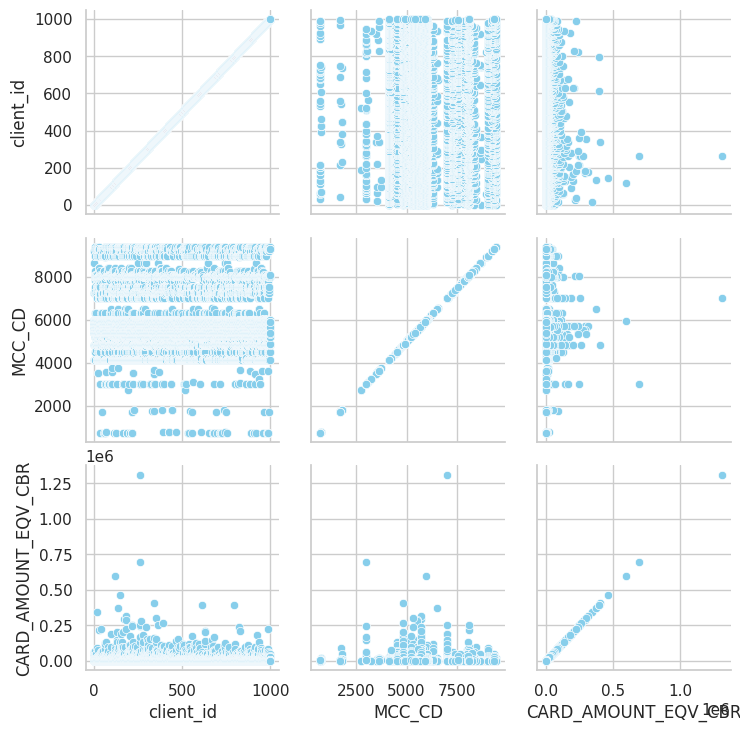

In [ ]:
sns.set(style="whitegrid")
g = sns.PairGrid(transactions)
g.map(sns.scatterplot, color='skyblue')
plt.show()

In [ ]:
# Dictionary to map the values
kind_mapping = {
    'Авиалинии, авиакомпании': 1,
    'Автомобили и транспортные средства': 2,
    'Аренда автомобилей': 3,
    'Бизнес услуги': 4,
    'Государственные услуги': 5,
    'Коммунальные и кабельные услуги': 6,
    'Контрактные услуги': 7,
    'Личные услуги': 8,
    'Магазины одежды': 9,
    'Оптовые поставщики и производители': 10,
    'Отели и мотели': 11,
    'Продажи по почте/телефону': 12,
    'Профессиональные услуги': 13,
    'Развлечения': 14,
    'Различные магазины': 15,
    'Розничные магазины': 16,
    'Строительные магазины': 17,
    'Транспортные услуги': 18,
    'Финансовые услуги': 19,
    'Членские взносы': 20,
}

transactions['trkind_num'] = transactions['MCC_KIND_CD'].map(kind_mapping)

In [ ]:
transactions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77666 entries, 0 to 77665
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   client_id            77666 non-null  int64         
 1   TRANSACTION_DT       77666 non-null  datetime64[ns]
 2   MCC_KIND_CD          77439 non-null  object        
 3   MCC_CD               77466 non-null  float64       
 4   CARD_AMOUNT_EQV_CBR  77666 non-null  float64       
 5   trkind_num           77439 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(1), object(1)
memory usage: 3.6+ MB


In [ ]:
# Find missing values
transactions[transactions.isna().any(axis=1)]

,client_id,TRANSACTION_DT,MCC_KIND_CD,MCC_CD,CARD_AMOUNT_EQV_CBR,trkind_num
397,6,2020-09-19,NaN,NaN,1365.36,NaN
971,14,2020-02-09,NaN,NaN,59.00,NaN
1006,15,2020-01-09,NaN,NaN,3840.66,NaN
1083,16,2020-02-09,NaN,NaN,59.00,NaN
1213,19,2020-09-28,NaN,NaN,340599.00,NaN
...,...,...,...,...,...,...
76606,986,2020-09-23,NaN,NaN,54000.00,NaN
76680,987,2020-09-23,NaN,NaN,225000.00,NaN
76894,990,2020-01-09,NaN,742.0,4264.00,NaN
76915,990,2020-04-09,NaN,742.0,400.00,NaN


В данной таблице есть пропуски. Отобразим их:

In [ ]:
# checking MCC_CD
desired_mcc_cd = 780.0

# using indexing
transactions[transactions['MCC_CD'] == desired_mcc_cd]

,client_id,TRANSACTION_DT,MCC_KIND_CD,MCC_CD,CARD_AMOUNT_EQV_CBR,trkind_num
5073,69,2020-10-09,NaN,780.0,445.0,NaN
5074,69,2020-10-09,NaN,780.0,210.0,NaN
5126,69,2020-09-30,Контрактные услуги,780.0,460.0,7.0
30164,393,2020-09-20,Контрактные услуги,780.0,900.0,7.0
32499,427,2020-08-09,NaN,780.0,20930.0,NaN
32505,427,2020-09-19,Контрактные услуги,780.0,8970.0,7.0
32518,427,2020-09-29,Контрактные услуги,780.0,2590.0,7.0
34769,464,2020-09-21,Контрактные услуги,780.0,1000.0,7.0
45557,608,2020-11-09,NaN,780.0,1621.0,NaN
55817,741,2020-09-29,Контрактные услуги,780.0,150.0,7.0


In [ ]:
# Check for missing values
missing_values = transactions.isnull().sum()
print(missing_values)
# Drop rows with missing values
transactions = transactions.dropna()

client_id                0
TRANSACTION_DT           0
MCC_KIND_CD            227
MCC_CD                 200
CARD_AMOUNT_EQV_CBR      0
trkind_num             227
dtype: int64


In [ ]:
# Check the uniqueness of combinations of MCC_KIND_CD and MCC_CD
uniq_comb = transactions.groupby(['MCC_KIND_CD', 'MCC_CD']).size().reset_index(name='count')
nuniq_comb = uniq_comb[uniq_comb['count'] > 1]

# Print the non-unique combinations
print("Non-unique combinations of MCC_KIND_CD and MCC_CD:")
print(nuniq_comb)
#As we could see here, MCC_KIND_CD and MCC_CD are not in one to one correspondance, so we need to keep both of them

Non-unique combinations of MCC_KIND_CD and MCC_CD:
                            MCC_KIND_CD  MCC_CD  count
0               Авиалинии, авиакомпании  3011.0     65
1               Авиалинии, авиакомпании  3026.0      2
4               Авиалинии, авиакомпании  3246.0      2
5    Автомобили и транспортные средства  5511.0     56
6    Автомобили и транспортные средства  5521.0     11
..                                  ...     ...    ...
230                   Финансовые услуги  6513.0     19
232                   Финансовые услуги  7032.0     10
233                     Членские взносы  8398.0     36
234                     Членские взносы  8641.0      9
235                     Членские взносы  8661.0     10

[211 rows x 3 columns]


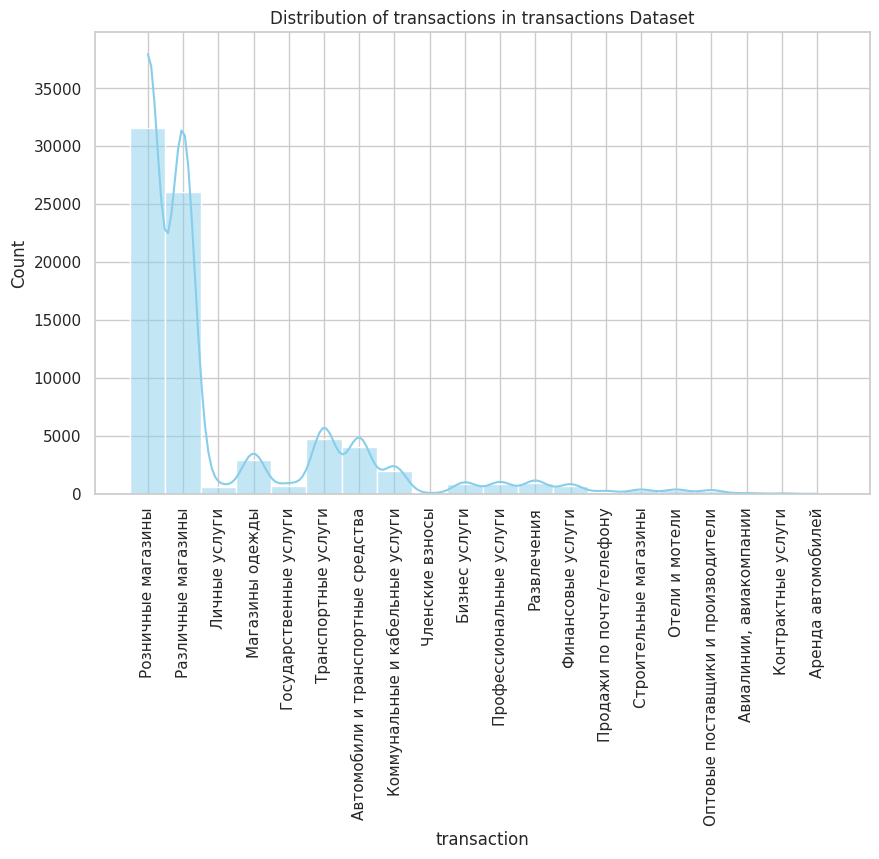

In [ ]:
# A distribution plot for Age
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.histplot(transactions['MCC_KIND_CD'], kde=True, bins=20, color='skyblue')
plt.xticks(rotation=90)
plt.title('Distribution of transactions in transactions Dataset')
plt.xlabel('transaction')
plt.ylabel('Count')
plt.show()

## Data merging

In [ ]:
tr_summary = transactions.groupby('client_id')['CARD_AMOUNT_EQV_CBR'].agg(['mean', 'count', 'min', 'max', 'median', lambda x: x.quantile(0.25), lambda x: x.quantile(0.75)]).reset_index()

# Renameing the columns
tr_summary.columns = ['client_id', 'avg_tr', 'tr_count', 'min_tr', 'max_tr', 'median_tr', 'q1_tr', 'q3_tr']

# One to one merge with clients dataset
df_1mrg = pd.merge(clients, tr_summary, on='client_id', how='left')

In [ ]:
display(df_1mrg)

,client_id,age,gender_code,directory,aMRG_eop,aCSH_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,dir_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr
0,1,38,Ж,Санкт-Петербург,0.00,742601.31,0.0,0.00,166353.83,0.00,0.0,286133.38,114454.28,2,2,2543.428444,45,5.90,63040.00,450.00,143.0000,1044.1000
1,2,38,Ж,Нижний Новгород,0.00,250000.00,540.0,0.00,372.19,0.00,0.0,107920.36,92437.27,2,3,1886.474898,49,3.00,38600.00,623.38,221.0000,1428.0000
2,3,37,Ж,Нижний Новгород,0.00,247232.80,0.0,0.00,89735.56,0.00,0.0,88649.15,73698.68,2,3,818.874222,90,26.00,7497.00,390.00,193.6525,1195.8425
3,4,37,М,Нижний Новгород,0.00,1195448.42,0.0,0.00,314498.64,0.00,0.0,198273.64,133039.22,1,3,992.830000,134,0.25,29990.00,450.00,214.0000,774.0000
4,5,58,М,Нижний Новгород,5045174.72,0.00,0.0,0.81,179383.40,0.00,0.0,158434.28,54120.55,1,3,2174.390741,27,315.50,14529.00,1529.00,607.1000,2382.5000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,48,Ж,Новый Уренгой,0.00,1000000.00,0.0,1500000.00,243169.83,263298.50,0.0,117428.00,90782.05,2,12,1488.230328,61,34.00,28898.95,621.00,390.0000,1253.4000
996,997,51,М,Новый Уренгой,469532.28,0.00,0.0,0.00,70391.45,351.08,0.0,205222.71,83319.15,1,12,1322.526190,63,13.70,46480.00,213.00,128.1250,735.2500
997,998,49,М,Тюмень,0.00,1204003.78,0.0,45.00,56496.65,0.00,0.0,137305.88,165253.09,1,26,11039.000000,1,11039.00,11039.00,11039.00,11039.0000,11039.0000
998,999,45,Ж,Сургут,0.00,655645.42,0.0,43.45,89718.27,0.00,380000.0,97142.73,216913.16,2,20,2464.922273,88,20.00,34066.40,888.75,235.7500,1871.2500


# Features engineering

We are using aCSH_eop for creating target variable. aCSH_eop is showing loan balance, but here we consider, that if aCSH_eop = 0, then client have no Consumer Credit(of course client could take credit and then pay it and in that case loan would be 0, but in this dataset we do not have any other variable, which shows more concreat information about consumer credit).

In [ ]:
df_kind = transactions.pivot_table(index='client_id', columns='MCC_KIND_CD', values='CARD_AMOUNT_EQV_CBR', aggfunc='sum', fill_value=0).reset_index()


# Rename the columns
#df_transposed.columns = ['client_id'] + [kind_mapping.get(col, col) for col in df_transposed.columns[1:]]
column_names = ['client_id'] + ['kind_' + str(kind_mapping[col]) if col in kind_mapping else col for col in df_kind.columns[1:]]
df_kind.columns = column_names

# Convert to binary version
#for col in df_transposed.columns[1:]:
#    df_transposed[col] = (df_transposed[col] > 0).astype(int)

#df_kind = transactions[['client_id']].merge(df_kind, on='client_id', how='left').fillna(0)

# Print the transposed dataset
print(len(df_kind))
display(df_kind)

1000


,client_id,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20
0,1,0.0,0.00,0.0,0.00,290.00,0.00,0.0,3707.0,22550.0,0.0,0.0,0.00,0.0,0.00,77774.87,9122.41,0.0,1010.00,0.00,0.0
1,2,0.0,5755.54,0.0,0.00,0.00,1428.00,0.0,0.0,58070.0,0.0,0.0,0.00,0.0,0.00,8749.76,16653.97,0.0,90.00,0.00,1690.0
2,3,0.0,6227.09,0.0,2500.00,252.50,0.00,0.0,0.0,19800.0,0.0,0.0,0.00,4509.0,0.00,13585.90,26489.19,0.0,335.00,0.00,0.0
3,4,0.0,0.00,0.0,1834.38,0.25,33141.26,0.0,450.0,12621.0,0.0,0.0,0.00,2439.5,2020.79,40871.63,19582.91,0.0,20077.50,0.00,0.0
4,5,0.0,9579.00,0.0,0.00,0.00,0.00,0.0,0.0,3984.0,0.0,0.0,0.00,0.0,3000.00,380.00,31286.87,0.0,4435.56,6043.12,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,0.0,0.00,0.0,0.00,4100.00,28998.95,0.0,0.0,6994.0,0.0,0.0,5375.54,0.0,0.00,11306.49,34007.07,0.0,0.00,0.00,0.0
996,997,0.0,855.00,0.0,0.00,0.00,0.00,0.0,0.0,9949.0,2541.0,0.0,0.00,0.0,0.00,50619.57,19354.58,0.0,0.00,0.00,0.0
997,998,0.0,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.0,11039.00,0.00,0.0
998,999,0.0,0.00,0.0,0.00,38054.00,6543.84,0.0,0.0,60453.5,0.0,0.0,0.00,36966.4,0.00,28461.35,46052.07,0.0,382.00,0.00,0.0


In [ ]:
df_1mrg = pd.merge(df_1mrg, df_kind, on='client_id', how='left')
display(df_1mrg)

,client_id,age,gender_code,directory,aMRG_eop,aCSH_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,dir_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20
0,1,38,Ж,Санкт-Петербург,0.00,742601.31,0.0,0.00,166353.83,0.00,0.0,286133.38,114454.28,2,2,2543.428444,45,5.90,63040.00,450.00,143.0000,1044.1000,0.0,0.00,0.0,0.00,290.00,0.00,0.0,3707.0,22550.0,0.0,0.0,0.00,0.0,0.00,77774.87,9122.41,0.0,1010.00,0.00,0.0
1,2,38,Ж,Нижний Новгород,0.00,250000.00,540.0,0.00,372.19,0.00,0.0,107920.36,92437.27,2,3,1886.474898,49,3.00,38600.00,623.38,221.0000,1428.0000,0.0,5755.54,0.0,0.00,0.00,1428.00,0.0,0.0,58070.0,0.0,0.0,0.00,0.0,0.00,8749.76,16653.97,0.0,90.00,0.00,1690.0
2,3,37,Ж,Нижний Новгород,0.00,247232.80,0.0,0.00,89735.56,0.00,0.0,88649.15,73698.68,2,3,818.874222,90,26.00,7497.00,390.00,193.6525,1195.8425,0.0,6227.09,0.0,2500.00,252.50,0.00,0.0,0.0,19800.0,0.0,0.0,0.00,4509.0,0.00,13585.90,26489.19,0.0,335.00,0.00,0.0
3,4,37,М,Нижний Новгород,0.00,1195448.42,0.0,0.00,314498.64,0.00,0.0,198273.64,133039.22,1,3,992.830000,134,0.25,29990.00,450.00,214.0000,774.0000,0.0,0.00,0.0,1834.38,0.25,33141.26,0.0,450.0,12621.0,0.0,0.0,0.00,2439.5,2020.79,40871.63,19582.91,0.0,20077.50,0.00,0.0
4,5,58,М,Нижний Новгород,5045174.72,0.00,0.0,0.81,179383.40,0.00,0.0,158434.28,54120.55,1,3,2174.390741,27,315.50,14529.00,1529.00,607.1000,2382.5000,0.0,9579.00,0.0,0.00,0.00,0.00,0.0,0.0,3984.0,0.0,0.0,0.00,0.0,3000.00,380.00,31286.87,0.0,4435.56,6043.12,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,48,Ж,Новый Уренгой,0.00,1000000.00,0.0,1500000.00,243169.83,263298.50,0.0,117428.00,90782.05,2,12,1488.230328,61,34.00,28898.95,621.00,390.0000,1253.4000,0.0,0.00,0.0,0.00,4100.00,28998.95,0.0,0.0,6994.0,0.0,0.0,5375.54,0.0,0.00,11306.49,34007.07,0.0,0.00,0.00,0.0
996,997,51,М,Новый Уренгой,469532.28,0.00,0.0,0.00,70391.45,351.08,0.0,205222.71,83319.15,1,12,1322.526190,63,13.70,46480.00,213.00,128.1250,735.2500,0.0,855.00,0.0,0.00,0.00,0.00,0.0,0.0,9949.0,2541.0,0.0,0.00,0.0,0.00,50619.57,19354.58,0.0,0.00,0.00,0.0
997,998,49,М,Тюмень,0.00,1204003.78,0.0,45.00,56496.65,0.00,0.0,137305.88,165253.09,1,26,11039.000000,1,11039.00,11039.00,11039.00,11039.0000,11039.0000,0.0,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.0,11039.00,0.00,0.0
998,999,45,Ж,Сургут,0.00,655645.42,0.0,43.45,89718.27,0.00,380000.0,97142.73,216913.16,2,20,2464.922273,88,20.00,34066.40,888.75,235.7500,1871.2500,0.0,0.00,0.0,0.00,38054.00,6543.84,0.0,0.0,60453.5,0.0,0.0,0.00,36966.4,0.00,28461.35,46052.07,0.0,382.00,0.00,0.0


In [ ]:
df_1mrg.columns

Index(['client_id', 'age', 'gender_code', 'directory', 'aMRG_eop', 'aCSH_eop',
       'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S',
       'tPOS_S', 'gnd_num', 'dir_num', 'avg_tr', 'tr_count', 'min_tr',
       'max_tr', 'median_tr', 'q1_tr', 'q3_tr', 'kind_1', 'kind_2', 'kind_3',
       'kind_4', 'kind_5', 'kind_6', 'kind_7', 'kind_8', 'kind_9', 'kind_10',
       'kind_11', 'kind_12', 'kind_13', 'kind_14', 'kind_15', 'kind_16',
       'kind_17', 'kind_18', 'kind_19', 'kind_20'],
      dtype='object')

In [ ]:
age_values = df_1mrg['age'].values.reshape(-1, 1)

#grouping age
bins = [18, 25, 35, 45, 55, 65, 100]
labels = ['18-25', '26-35', '36-45', '46-55', '56-65', '66+']
df_1mrg['age_group'] = pd.cut(df_1mrg['age'], bins=bins, labels=labels, right=False)
#display(df_merged)

## Checking dependencies in dataset

In [ ]:
selected_columns = ['aMRG_eop', 'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S', 'tPOS_S', 'avg_tr']
corr = df_1mrg[selected_columns].corr()

# Create the heatmap
plt.figure(figsize=(12, 10), dpi=80)
heatmap = sns.heatmap(corr, xticklabels=corr.columns, yticklabels=corr.columns, center=0, annot=True)
plt.show()
heatmap.get_figure().savefig("corr.png")

In [ ]:
matrix_p = df_1mrg[selected_columns].phik_matrix(interval_cols=selected_columns)
display(matrix_p)

,aMRG_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,avg_tr
aMRG_eop,1.000000,0.000000,0.201482,0.264302,0.379329,0.328006,0.425545,0.228366,0.624608
aCRD_eop,0.000000,1.000000,0.000000,0.188556,0.048927,0.098298,0.000000,0.358750,0.216139
pCUR_eop,0.201482,0.000000,1.000000,0.264030,0.541836,0.392526,0.250628,0.086852,0.414309
pCRD_eop,0.264302,0.188556,0.264030,1.000000,0.567929,0.110796,0.636755,0.305613,0.115530
pSAV_eop,0.379329,0.048927,0.541836,0.567929,1.000000,0.271166,0.281191,0.292354,0.073544
pDEP_eop,0.328006,0.098298,0.392526,0.110796,0.271166,1.000000,0.371850,0.000000,0.000000
sWork_S,0.425545,0.000000,0.250628,0.636755,0.281191,0.371850,1.000000,0.275649,0.000000
tPOS_S,0.228366,0.358750,0.086852,0.305613,0.292354,0.000000,0.275649,1.000000,0.416015
avg_tr,0.624608,0.216139,0.414309,0.115530,0.073544,0.000000,0.000000,0.416015,1.000000


In [ ]:
plt.figure(figsize = (12,10), dpi=80)
sns.heatmap(matrix_p,
           vmax=1,
           square=True,
           annot=True,
           cmap='coolwarm',
           center=0,
           annot_kws={'size':12})

In [ ]:
# Set the style
sns.set(style="whitegrid")

# Create the catplot with the specified style
plt.figure(figsize=(10, 6))
sns.catplot(data=df_1mrg, x="aCSH_eop", y="gender_code", kind="box", palette="pastel")
plt.title('Boxplot of Consumer Loan Debt Balance by Gender')
plt.xlabel('Consumer Loan Debt Balance')
plt.ylabel('Gender')
plt.show()

In [ ]:
selc_columns = ['aMRG_eop', 'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S','aCSH_eop', 'tPOS_S', 'gender_code']
sns.pairplot(df_1mrg[selc_columns], hue="gender_code", height=2.5, palette="pastel")

In [ ]:
# A distribution plot for age and consumer credit
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.scatterplot(data = df_1mrg, x = clients['age'], y =clients['aCSH_eop'], color='skyblue')
plt.title('Scatterplot of Loan Debt Balance by Age')
plt.xlabel('Age')
plt.ylabel('consumer credit')
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.displot(df_1mrg, x="aCSH_eop", hue="age_group", kind="kde", palette="pastel")
plt.title('Kernel Density Estimate of Consumer Loan Debt Balance by Age Category')
plt.xlabel('Consumer Loan Debt Balance')
plt.ylabel('Density')
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.catplot(data=df_1mrg, x="age_group", y="aCSH_eop", hue = "gender_code", kind="swarm", palette="pastel")
plt.title('Consumer Loan Debt Balance by Age Category and Gender')
plt.xlabel('Age group')
plt.ylabel('Consumer Loan Debt Balance')
plt.show()

In [ ]:
# A distribution plot for directory
sns.set(style="whitegrid")
plt.figure(figsize=(12, 8))
ax = sns.catplot(data=df_1mrg, x="directory", y="aCSH_eop", color='skyblue')
ax.set_xticklabels(rotation=90)
plt.title('Consumer Loan Debt Balance by Location')
plt.xlabel('City')
plt.ylabel('Consumer Loan Balance')
plt.tight_layout()
plt.show()

In [ ]:
# A distribution plot for age and consumer credit
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.scatterplot(data = df_1mrg, x = clients['sWork_S'], y =clients['aCSH_eop'], color='skyblue')
plt.title('Consumer Loan Debt Balance by Monthly salary')
plt.xlabel('Monthly salary')
plt.ylabel('Consumer credit')
plt.show()

In [ ]:
# A distribution plot for age and consumer credit
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.scatterplot(data = df_1mrg, x = clients['pCUR_eop'], y =clients['aCSH_eop'], color='skyblue')
plt.title('Consumer Loan Debt Balance by Current account balance')
plt.xlabel('Current account balance')
plt.ylabel('Consumer credit')
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.relplot(data=df_1mrg, x="aCRD_eop", y="aCSH_eop", hue="gender_code", palette="pastel")
plt.title('Consumer Loan Debt Balance by Credit card debt balance, showing by gender')
plt.xlabel('Credit card debt balance')
plt.ylabel('Consumer credit')
plt.show()


In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.relplot(data=df_1mrg, x="pSAV_eop", y="aCSH_eop", hue="gender_code", palette="pastel")
plt.title('Consumer Loan Debt Balance by Savings account balance, showing by gender')
plt.xlabel('Savings account balance')
plt.ylabel('Consumer credit')
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.relplot(data=df_1mrg, x="pDEP_eop", y="aCSH_eop", hue="gender_code", palette="pastel")
plt.title('Consumer Loan Debt Balance by Deposit account balance, showing by gender')
plt.xlabel('Deposit account balance')
plt.ylabel('Consumer credit')
plt.show()


In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.relplot(data=df_1mrg, x="tPOS_S", y="aCSH_eop", hue="gender_code", palette="pastel")
plt.title('Consumer Loan Debt Balance by POS transaction amount, showing by gender')
plt.xlabel('POS transaction amount')
plt.ylabel('Consumer credit')
plt.show()


In [ ]:
# Setting threshold
threshold = 0.0

# Creating target variable
df_1mrg['Target'] = (df_1mrg['aCSH_eop'] > threshold).astype('int8')
df_1mrg.drop(columns=['aCSH_eop'])

,client_id,age,gender_code,directory,aMRG_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,dir_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20,age_group,Target
0,1,38,Ж,Санкт-Петербург,0.00,0.0,0.00,166353.83,0.00,0.0,286133.38,114454.28,2,2,2543.428444,45,5.90,63040.00,450.00,143.0000,1044.1000,0.0,0.00,0.0,0.00,290.00,0.00,0.0,3707.0,22550.0,0.0,0.0,0.00,0.0,0.00,77774.87,9122.41,0.0,1010.00,0.00,0.0,36-45,1
1,2,38,Ж,Нижний Новгород,0.00,540.0,0.00,372.19,0.00,0.0,107920.36,92437.27,2,3,1886.474898,49,3.00,38600.00,623.38,221.0000,1428.0000,0.0,5755.54,0.0,0.00,0.00,1428.00,0.0,0.0,58070.0,0.0,0.0,0.00,0.0,0.00,8749.76,16653.97,0.0,90.00,0.00,1690.0,36-45,1
2,3,37,Ж,Нижний Новгород,0.00,0.0,0.00,89735.56,0.00,0.0,88649.15,73698.68,2,3,818.874222,90,26.00,7497.00,390.00,193.6525,1195.8425,0.0,6227.09,0.0,2500.00,252.50,0.00,0.0,0.0,19800.0,0.0,0.0,0.00,4509.0,0.00,13585.90,26489.19,0.0,335.00,0.00,0.0,36-45,1
3,4,37,М,Нижний Новгород,0.00,0.0,0.00,314498.64,0.00,0.0,198273.64,133039.22,1,3,992.830000,134,0.25,29990.00,450.00,214.0000,774.0000,0.0,0.00,0.0,1834.38,0.25,33141.26,0.0,450.0,12621.0,0.0,0.0,0.00,2439.5,2020.79,40871.63,19582.91,0.0,20077.50,0.00,0.0,36-45,1
4,5,58,М,Нижний Новгород,5045174.72,0.0,0.81,179383.40,0.00,0.0,158434.28,54120.55,1,3,2174.390741,27,315.50,14529.00,1529.00,607.1000,2382.5000,0.0,9579.00,0.0,0.00,0.00,0.00,0.0,0.0,3984.0,0.0,0.0,0.00,0.0,3000.00,380.00,31286.87,0.0,4435.56,6043.12,0.0,56-65,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,48,Ж,Новый Уренгой,0.00,0.0,1500000.00,243169.83,263298.50,0.0,117428.00,90782.05,2,12,1488.230328,61,34.00,28898.95,621.00,390.0000,1253.4000,0.0,0.00,0.0,0.00,4100.00,28998.95,0.0,0.0,6994.0,0.0,0.0,5375.54,0.0,0.00,11306.49,34007.07,0.0,0.00,0.00,0.0,46-55,1
996,997,51,М,Новый Уренгой,469532.28,0.0,0.00,70391.45,351.08,0.0,205222.71,83319.15,1,12,1322.526190,63,13.70,46480.00,213.00,128.1250,735.2500,0.0,855.00,0.0,0.00,0.00,0.00,0.0,0.0,9949.0,2541.0,0.0,0.00,0.0,0.00,50619.57,19354.58,0.0,0.00,0.00,0.0,46-55,0
997,998,49,М,Тюмень,0.00,0.0,45.00,56496.65,0.00,0.0,137305.88,165253.09,1,26,11039.000000,1,11039.00,11039.00,11039.00,11039.0000,11039.0000,0.0,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.0,11039.00,0.00,0.0,46-55,1
998,999,45,Ж,Сургут,0.00,0.0,43.45,89718.27,0.00,380000.0,97142.73,216913.16,2,20,2464.922273,88,20.00,34066.40,888.75,235.7500,1871.2500,0.0,0.00,0.0,0.00,38054.00,6543.84,0.0,0.0,60453.5,0.0,0.0,0.00,36966.4,0.00,28461.35,46052.07,0.0,382.00,0.00,0.0,46-55,1


In [ ]:
selc_columns = ['aMRG_eop', 'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S', 'tPOS_S', 'Target']
sns.pairplot(df_1mrg[selc_columns], hue="Target", height=2.5, palette="pastel")

In [ ]:
def transform_get_fitted_StandardScaler(df, columns):
    scaler_std = StandardScaler()
    return scaler_std.fit_transform(df[columns]), scaler_std

In [ ]:
def transform_get_fitted_MinMaxScaler(df, columns):
    scaler_mnx = MinMaxScaler()
    return scaler_mnx.fit_transform(df[columns]), scaler_mnx

In [ ]:
# One-Hot encoding for directory
print(df_1mrg['directory'].nunique())
df_1mrg['directory'].unique()
df_1mrg = pd.get_dummies(df_1mrg, columns=['dir_num', ])
df_1mrg

31


,client_id,age,gender_code,directory,aMRG_eop,aCSH_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20,age_group,Target,dir_num_1,dir_num_2,dir_num_3,dir_num_4,dir_num_5,dir_num_6,dir_num_7,dir_num_8,dir_num_9,dir_num_10,dir_num_11,dir_num_12,dir_num_13,dir_num_14,dir_num_15,dir_num_16,dir_num_17,dir_num_18,dir_num_19,dir_num_20,dir_num_21,dir_num_22,dir_num_23,dir_num_24,dir_num_25,dir_num_26,dir_num_27,dir_num_28,dir_num_29,dir_num_30,dir_num_31
0,1,38,Ж,Санкт-Петербург,0.00,742601.31,0.0,0.00,166353.83,0.00,0.0,286133.38,114454.28,2,2543.428444,45,5.90,63040.00,450.00,143.0000,1044.1000,0.0,0.00,0.0,0.00,290.00,0.00,0.0,3707.0,22550.0,0.0,0.0,0.00,0.0,0.00,77774.87,9122.41,0.0,1010.00,0.00,0.0,36-45,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2,38,Ж,Нижний Новгород,0.00,250000.00,540.0,0.00,372.19,0.00,0.0,107920.36,92437.27,2,1886.474898,49,3.00,38600.00,623.38,221.0000,1428.0000,0.0,5755.54,0.0,0.00,0.00,1428.00,0.0,0.0,58070.0,0.0,0.0,0.00,0.0,0.00,8749.76,16653.97,0.0,90.00,0.00,1690.0,36-45,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3,37,Ж,Нижний Новгород,0.00,247232.80,0.0,0.00,89735.56,0.00,0.0,88649.15,73698.68,2,818.874222,90,26.00,7497.00,390.00,193.6525,1195.8425,0.0,6227.09,0.0,2500.00,252.50,0.00,0.0,0.0,19800.0,0.0,0.0,0.00,4509.0,0.00,13585.90,26489.19,0.0,335.00,0.00,0.0,36-45,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,4,37,М,Нижний Новгород,0.00,1195448.42,0.0,0.00,314498.64,0.00,0.0,198273.64,133039.22,1,992.830000,134,0.25,29990.00,450.00,214.0000,774.0000,0.0,0.00,0.0,1834.38,0.25,33141.26,0.0,450.0,12621.0,0.0,0.0,0.00,2439.5,2020.79,40871.63,19582.91,0.0,20077.50,0.00,0.0,36-45,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,5,58,М,Нижний Новгород,5045174.72,0.00,0.0,0.81,179383.40,0.00,0.0,158434.28,54120.55,1,2174.390741,27,315.50,14529.00,1529.00,607.1000,2382.5000,0.0,9579.00,0.0,0.00,0.00,0.00,0.0,0.0,3984.0,0.0,0.0,0.00,0.0,3000.00,380.00,31286.87,0.0,4435.56,6043.12,0.0,56-65,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,48,Ж,Новый Уренгой,0.00,1000000.00,0.0,1500000.00,243169.83,263298.50,0.0,117428.00,90782.05,2,1488.230328,61,34.00,28898.95,621.00,390.0000,1253.4000,0.0,0.00,0.0,0.00,4100.00,28998.95,0.0,0.0,6994.0,0.0,0.0,5375.54,0.0,0.00,11306.49,34007.07,0.0,0.00,0.00,0.0,46-55,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
996,997,51,М,Новый Уренгой,469532.28,0.00,0.0,0.00,70391.45,351.08,0.0,205222.71,83319.15,1,1322.526190,63,13.70,46480.00,213.00,128.1250,735.2500,0.0,855.00,0.0,0.00,0.00,0.00,0.0,0.0,9949.0,2541.0,0.0,0.00,0.0,0.00,50619.57,19354.58,0.0,0.00,0.00,0.0,46-55,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
997,998,49,М,Тюмень,0.00,1204003.78,0.0,45.00,56496.65,0.00,0.0,137305.88,165253.09,1,11039.000000,1,11039.00,11039.00,11039.00,11039.0000,11039.0000,0.0,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.0,11039.00,0.00,0.0,46-55,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
998,999,45,Ж,Сургут,0.00,655645.42,0.0,43.45,89718.27,0.00,380000.0,97142.73,216913.16,2,2464.922273,88,20.00,34066.40,888.75,235.7500,1871.2500,0.0,0.00,0.0,0.00,38054.00,6543.84,0.0,0.0,60453.5,0.0,0.0,0.00,36966.4,0.00,28461.35,46052.07,0.0,382.00,0.00,0.0,46-55,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_1mrg.shape

(1000, 74)

In [ ]:
df_1mrg.columns

Index(['client_id', 'age', 'gender_code', 'directory', 'aMRG_eop', 'aCSH_eop',
       'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S',
       'tPOS_S', 'gnd_num', 'avg_tr', 'tr_count', 'min_tr', 'max_tr',
       'median_tr', 'q1_tr', 'q3_tr', 'kind_1', 'kind_2', 'kind_3', 'kind_4',
       'kind_5', 'kind_6', 'kind_7', 'kind_8', 'kind_9', 'kind_10', 'kind_11',
       'kind_12', 'kind_13', 'kind_14', 'kind_15', 'kind_16', 'kind_17',
       'kind_18', 'kind_19', 'kind_20', 'age_group', 'Target', 'dir_num_1',
       'dir_num_2', 'dir_num_3', 'dir_num_4', 'dir_num_5', 'dir_num_6',
       'dir_num_7', 'dir_num_8', 'dir_num_9', 'dir_num_10', 'dir_num_11',
       'dir_num_12', 'dir_num_13', 'dir_num_14', 'dir_num_15', 'dir_num_16',
       'dir_num_17', 'dir_num_18', 'dir_num_19', 'dir_num_20', 'dir_num_21',
       'dir_num_22', 'dir_num_23', 'dir_num_24', 'dir_num_25', 'dir_num_26',
       'dir_num_27', 'dir_num_28', 'dir_num_29', 'dir_num_30', 'dir_num_31'],
      dtype=

In [ ]:
df_1mrg['gender'] = df_1mrg['gender_code']
df_1mrg['gender_code'] = df_1mrg['gender_code'].astype('category').cat.codes

In [ ]:
df_1mrg['age_group']

0      36-45
1      36-45
2      36-45
3      36-45
4      56-65
       ...  
995    46-55
996    46-55
997    46-55
998    46-55
999    36-45
Name: age_group, Length: 1000, dtype: category
Categories (6, object): ['18-25' < '26-35' < '36-45' < '46-55' < '56-65' < '66+']

In [ ]:
df_1mrg['age_code'] = df_1mrg['age_group'].cat.codes

### Visualizing categorical features by target

In [ ]:
def plot_stacked_bar(data, category, target, ax):
    # Calculate the count of values for each category
    counts = data.groupby([category, target]).size().unstack()

    # If there are N/D values, move them to the end for better visualization
    if 'N/D' in counts.index:
        n_d = counts.loc['N/D']
        counts = counts.drop('N/D')
        counts.loc['N/D'] = n_d

    # Normalize the data so that the sum for each category equals 1
    counts = counts.T.div(counts.T.sum()).T

    # Plot stacked bars
    bars = counts.plot(kind='bar', stacked=True, ax=ax, color=['#1f77b4', '#d62728'])

    # Add horizontal dashed lines
    for yval in ax.get_yticks():
        ax.axhline(y=yval, linestyle='--', color='grey', alpha=0.7)

    ax.set_title(f'Stacked Bar Chart of {category}')
    ax.set_ylabel('Proportion of Customers')
    ax.set_xlabel(category)
    ax.legend(title=target, loc='upper right')

    return bars

In [ ]:
def draw_df_per_target(df, target, categorical_columns, rows=5, cols=3, figsize=(15, 22)):
    # Draw stacked bars for each categorical column with valid data
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=figsize)
    axes = axes.flatten()  # Convert the array of axes into a one-dimensional array

    # Plotting graphs for each categorical feature
    for ax, category in zip(axes, categorical_columns):
        plot_stacked_bar(df, category, target, ax)

    # Remove excess axes, if any
    for i in range(len(categorical_columns), len(axes)):
        fig.delaxes(axes[i])

    # Adjust the spacing between subplots
    plt.tight_layout()
    plt.show()

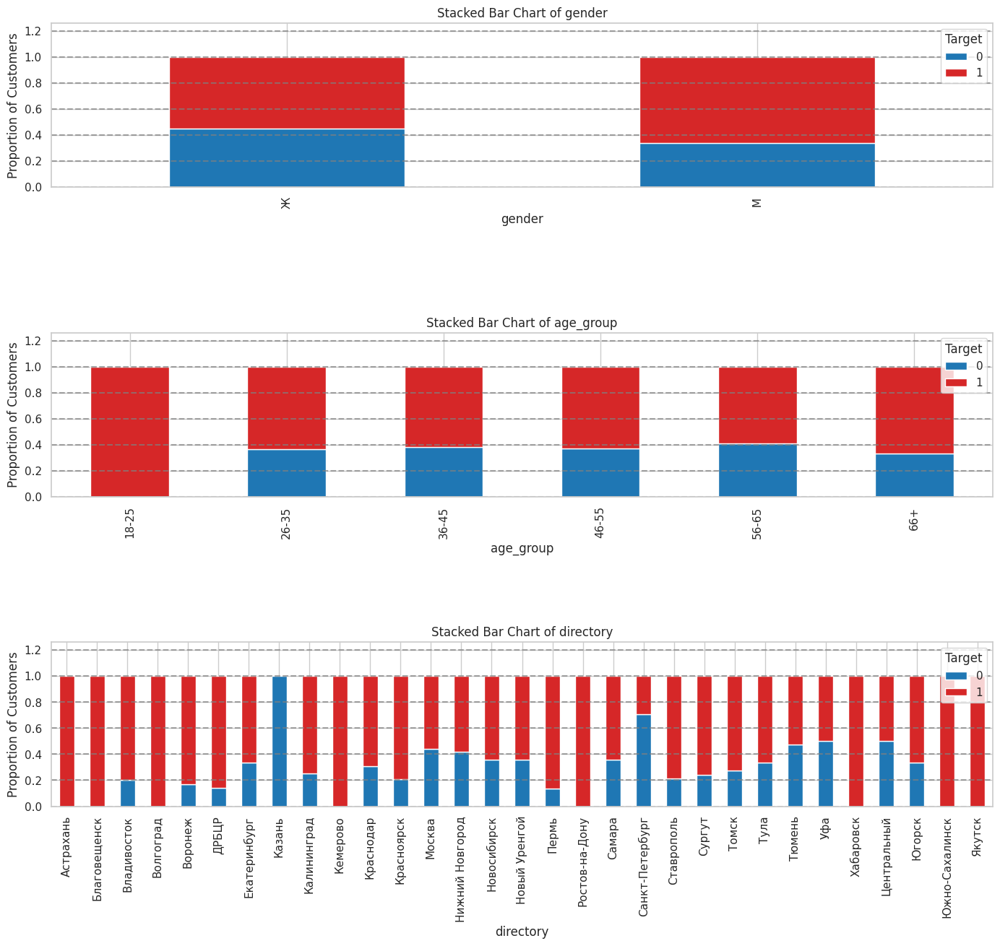

In [ ]:
draw_df_per_target(df_1mrg, 'Target', ['gender', 'age_group', 'directory'], figsize=(14, 20), cols=1)

# Machine learning/Model part

In [ ]:
FEATURES = df_1mrg.drop(columns=['client_id', 'directory', 'aCSH_eop', 'Target', 'gender', 'age_group']).columns.tolist()

In [ ]:
df_1mrg[FEATURES]

,age,gender_code,aMRG_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20,dir_num_1,dir_num_2,dir_num_3,dir_num_4,dir_num_5,dir_num_6,dir_num_7,dir_num_8,dir_num_9,dir_num_10,dir_num_11,dir_num_12,dir_num_13,dir_num_14,dir_num_15,dir_num_16,dir_num_17,dir_num_18,dir_num_19,dir_num_20,dir_num_21,dir_num_22,dir_num_23,dir_num_24,dir_num_25,dir_num_26,dir_num_27,dir_num_28,dir_num_29,dir_num_30,dir_num_31,age_code
0,38,0,0.00,0.0,0.00,166353.83,0.00,0.0,286133.38,114454.28,2,2543.428444,45,5.90,63040.00,450.00,143.0000,1044.1000,0.0,0.00,0.0,0.00,290.00,0.00,0.0,3707.0,22550.0,0.0,0.0,0.00,0.0,0.00,77774.87,9122.41,0.0,1010.00,0.00,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
1,38,0,0.00,540.0,0.00,372.19,0.00,0.0,107920.36,92437.27,2,1886.474898,49,3.00,38600.00,623.38,221.0000,1428.0000,0.0,5755.54,0.0,0.00,0.00,1428.00,0.0,0.0,58070.0,0.0,0.0,0.00,0.0,0.00,8749.76,16653.97,0.0,90.00,0.00,1690.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
2,37,0,0.00,0.0,0.00,89735.56,0.00,0.0,88649.15,73698.68,2,818.874222,90,26.00,7497.00,390.00,193.6525,1195.8425,0.0,6227.09,0.0,2500.00,252.50,0.00,0.0,0.0,19800.0,0.0,0.0,0.00,4509.0,0.00,13585.90,26489.19,0.0,335.00,0.00,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
3,37,1,0.00,0.0,0.00,314498.64,0.00,0.0,198273.64,133039.22,1,992.830000,134,0.25,29990.00,450.00,214.0000,774.0000,0.0,0.00,0.0,1834.38,0.25,33141.26,0.0,450.0,12621.0,0.0,0.0,0.00,2439.5,2020.79,40871.63,19582.91,0.0,20077.50,0.00,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
4,58,1,5045174.72,0.0,0.81,179383.40,0.00,0.0,158434.28,54120.55,1,2174.390741,27,315.50,14529.00,1529.00,607.1000,2382.5000,0.0,9579.00,0.0,0.00,0.00,0.00,0.0,0.0,3984.0,0.0,0.0,0.00,0.0,3000.00,380.00,31286.87,0.0,4435.56,6043.12,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,48,0,0.00,0.0,1500000.00,243169.83,263298.50,0.0,117428.00,90782.05,2,1488.230328,61,34.00,28898.95,621.00,390.0000,1253.4000,0.0,0.00,0.0,0.00,4100.00,28998.95,0.0,0.0,6994.0,0.0,0.0,5375.54,0.0,0.00,11306.49,34007.07,0.0,0.00,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
996,51,1,469532.28,0.0,0.00,70391.45,351.08,0.0,205222.71,83319.15,1,1322.526190,63,13.70,46480.00,213.00,128.1250,735.2500,0.0,855.00,0.0,0.00,0.00,0.00,0.0,0.0,9949.0,2541.0,0.0,0.00,0.0,0.00,50619.57,19354.58,0.0,0.00,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
997,49,1,0.00,0.0,45.00,56496.65,0.00,0.0,137305.88,165253.09,1,11039.000000,1,11039.00,11039.00,11039.00,11039.0000,11039.0000,0.0,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.0,11039.00,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,3
998,45,0,0.00,0.0,43.45,89718.27,0.00,380000.0,97142.73,216913.16,2,2464.922273,88,20.00,34066.40,888.75,235.7500,1871.2500,0.0,0.00,0.0,0.00,38054.00,6543.84,0.0,0.0,60453.5,0.0,0.0,0.00,36966.4,0.00,28461.35,46052.07,0.0,382.00,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3


In [ ]:
from sklearn.preprocessing import OneHotEncoder

Y = df_1mrg['Target']

In [ ]:
from sklearn.model_selection import train_test_split

train_ids, test_ids = train_test_split(
    df_1mrg.index, #X, Y,
    test_size=0.15,
    random_state = 123,
    shuffle = True,
    stratify=Y
)

# print("Train:")
# print(f"\tX: {X_train.shape}; Y: {y_train.shape}(avg: {y_train.mean()})")
# print("Test:")
# print(f"\tX: {X_test.shape}; Y: {y_test.shape}(avg: {y_test.mean()})")

In [ ]:
X_train = df_1mrg.loc[train_ids][FEATURES]
y_train = df_1mrg.loc[train_ids][['Target']]
X_test = df_1mrg.loc[test_ids][FEATURES]
y_test = df_1mrg.loc[test_ids][['Target']]

In [ ]:
X_test

,age,gender_code,aMRG_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20,dir_num_1,dir_num_2,dir_num_3,dir_num_4,dir_num_5,dir_num_6,dir_num_7,dir_num_8,dir_num_9,dir_num_10,dir_num_11,dir_num_12,dir_num_13,dir_num_14,dir_num_15,dir_num_16,dir_num_17,dir_num_18,dir_num_19,dir_num_20,dir_num_21,dir_num_22,dir_num_23,dir_num_24,dir_num_25,dir_num_26,dir_num_27,dir_num_28,dir_num_29,dir_num_30,dir_num_31,age_code
55,37,1,0.0,0.00,0.00,117246.45,0.00,0.0,229406.25,97841.95,1,2160.801389,36,40.00,38590.00,593.50,258.24,1049.3100,0.0,1068.03,0.0,0.0,0.00,0.00,0.0,0.0,2775.00,0.0,0.00,0.0,0.0,0.0,46333.15,27612.67,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
274,32,1,0.0,100.00,1.83,102694.55,0.00,0.0,135805.01,161815.35,1,803.794378,185,2.99,13740.00,284.00,116.00,862.9700,0.0,43074.95,0.0,0.0,4229.00,4130.00,0.0,850.0,15730.00,3100.0,0.00,0.0,0.0,0.0,34434.26,32630.75,3690.0,3833.0,3000.0,0.0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
726,43,1,0.0,0.00,0.00,120317.86,0.00,0.0,123392.40,62105.71,1,1129.194727,55,60.00,8894.28,783.00,325.80,1048.7000,0.0,5374.63,0.0,2570.0,0.00,10471.28,1014.0,0.0,15554.00,0.0,0.00,0.0,0.0,0.0,19424.10,7197.70,0.0,0.0,500.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2
262,36,1,0.0,469389.61,0.00,101314.57,0.00,0.0,292884.07,3032845.47,1,26839.340442,113,1.00,1310964.35,475.00,200.00,2635.5000,1119167.0,7402.40,0.0,600.0,0.00,115437.15,0.0,0.0,0.00,0.0,1570893.67,0.0,4000.0,0.0,124024.12,87886.13,0.0,3435.0,0.0,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
507,45,1,6891305.1,0.00,207818.13,1019375.09,0.00,0.0,1391160.49,354293.61,1,4661.758026,76,140.00,113625.00,1673.96,492.25,4557.0000,0.0,18021.08,0.0,0.0,0.00,3572.89,0.0,16551.0,164642.72,0.0,0.00,0.0,7240.0,2493.0,86265.38,29988.54,1729.0,23790.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198,57,1,12600000.0,0.00,0.00,959542.85,0.00,0.0,775687.75,196361.09,1,3167.114355,62,26.00,66415.00,550.50,231.00,1344.1525,0.0,0.00,0.0,0.0,0.00,0.00,0.0,2000.0,4370.00,0.0,0.00,0.0,4800.0,0.0,124393.63,58394.46,0.0,2403.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4
408,44,0,0.0,184258.01,252.09,56892.37,1207750.00,0.0,175691.28,545654.71,2,3737.361027,146,3.00,71557.00,505.40,184.25,1894.2500,0.0,71557.00,0.0,0.0,0.00,19440.00,0.0,17490.0,69877.50,0.0,0.00,0.0,47640.0,0.0,152623.30,86079.91,0.0,80947.0,0.0,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
569,41,1,0.0,0.00,0.00,100.00,150.19,0.0,89678.72,75798.16,1,3031.926400,25,20.00,72000.00,68.00,47.00,159.0000,0.0,0.00,0.0,72000.0,0.00,500.00,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,1298.16,0.00,0.0,0.0,2000.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
201,57,1,0.0,0.00,0.00,5800.06,0.00,0.0,328926.54,326090.59,1,2362.975290,138,29.00,34898.00,1305.00,292.50,2397.5275,0.0,9340.11,0.0,0.0,251.25,0.00,0.0,6550.0,26990.00,380.0,43010.00,0.0,1000.0,0.0,177395.50,58294.73,0.0,2879.0,0.0,0.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4


In [ ]:
X_train[FEATURES], scaler_st = transform_get_fitted_StandardScaler(X_train, FEATURES)
df_X_train = X_train[FEATURES]
X_test[FEATURES] = scaler_st.transform(X_test[FEATURES])
df_X_test = X_test[FEATURES]

In [ ]:
X_test

,age,gender_code,aMRG_eop,aCRD_eop,pCUR_eop,pCRD_eop,pSAV_eop,pDEP_eop,sWork_S,tPOS_S,gnd_num,avg_tr,tr_count,min_tr,max_tr,median_tr,q1_tr,q3_tr,kind_1,kind_2,kind_3,kind_4,kind_5,kind_6,kind_7,kind_8,kind_9,kind_10,kind_11,kind_12,kind_13,kind_14,kind_15,kind_16,kind_17,kind_18,kind_19,kind_20,dir_num_1,dir_num_2,dir_num_3,dir_num_4,dir_num_5,dir_num_6,dir_num_7,dir_num_8,dir_num_9,dir_num_10,dir_num_11,dir_num_12,dir_num_13,dir_num_14,dir_num_15,dir_num_16,dir_num_17,dir_num_18,dir_num_19,dir_num_20,dir_num_21,dir_num_22,dir_num_23,dir_num_24,dir_num_25,dir_num_26,dir_num_27,dir_num_28,dir_num_29,dir_num_30,dir_num_31,age_code
55,-0.648278,0.723393,-0.426583,-0.461791,-0.114278,-0.077180,-0.206156,-0.165808,0.173719,-0.283280,-0.723393,-0.100805,-0.943921,-0.062873,0.115448,-0.100333,-0.082632,-0.169339,-0.118783,-0.387776,-0.036854,-0.162203,-0.224771,-0.198179,-0.069021,-0.260584,-0.427744,-0.100129,-0.207301,-0.183469,-0.292202,-0.181687,0.190591,-0.170183,-0.197889,-0.387809,-0.166260,-0.06363,-0.572822,-0.341982,-0.114503,-0.048564,-0.177633,-0.03432,-0.048564,-0.166767,-0.103448,-0.114503,-0.076923,2.649315,-0.048564,-0.048564,-0.184562,-0.068761,-0.181126,-0.048564,-0.091125,-0.455397,-0.114503,-0.03432,-0.076923,-0.097474,-0.163003,-0.204124,-0.170457,-0.177633,-0.068761,-0.03432,-0.03432,-0.320442
274,-1.274172,0.723393,-0.426583,-0.460905,-0.114272,-0.116782,-0.206156,-0.165808,-0.291081,0.313318,-0.723393,-0.248925,2.524043,-0.069366,-0.412711,-0.140043,-0.104625,-0.185151,-0.118783,1.856201,-0.036854,-0.162203,0.762772,-0.074654,-0.069021,-0.106251,0.084179,0.272582,-0.207301,-0.183469,-0.292202,-0.181687,-0.024312,-0.044396,0.950478,-0.139558,-0.035090,-0.06363,-0.572822,-0.341982,-0.114503,-0.048564,-0.177633,-0.03432,-0.048564,-0.166767,-0.103448,-0.114503,13.000000,-0.377456,-0.048564,-0.048564,-0.184562,-0.068761,-0.181126,-0.048564,-0.091125,-0.455397,-0.114503,-0.03432,-0.076923,-0.097474,-0.163003,-0.204124,-0.170457,-0.177633,-0.068761,-0.03432,-0.03432,-1.494475
726,0.102794,0.723393,-0.426583,-0.461791,-0.114278,-0.068822,-0.206156,-0.165808,-0.352719,-0.616546,-0.723393,-0.213407,-0.501698,-0.059364,-0.515702,-0.076019,-0.072187,-0.169391,-0.118783,-0.157720,-0.036854,0.082985,-0.224771,0.115011,0.177189,-0.260584,0.077224,-0.100129,-0.207301,-0.183469,-0.292202,-0.181687,-0.295406,-0.681920,-0.197889,-0.387809,-0.144399,-0.06363,-0.572822,-0.341982,-0.114503,-0.048564,-0.177633,-0.03432,-0.048564,-0.166767,-0.103448,-0.114503,-0.076923,-0.377456,-0.048564,-0.048564,-0.184562,-0.068761,-0.181126,-0.048564,-0.091125,2.195887,-0.114503,-0.03432,-0.076923,-0.097474,-0.163003,-0.204124,-0.170457,-0.177633,-0.068761,-0.03432,-0.03432,-0.320442
262,-0.773457,0.723393,-0.426583,3.695329,-0.114278,-0.120537,-0.206156,-0.165808,0.488933,27.087732,-0.723393,2.592906,0.848248,-0.069715,27.158376,-0.115537,-0.091637,-0.034745,133.476963,-0.049398,-0.036854,-0.104960,-0.224771,3.254480,-0.069021,-0.260584,-0.537400,-0.100129,81.128445,-0.183469,-0.007906,-0.181687,1.593747,1.340677,-0.197889,-0.165336,-0.166260,-0.06363,1.745743,-0.341982,-0.114503,-0.048564,-0.177633,-0.03432,-0.048564,-0.166767,-0.103448,-0.114503,-0.076923,-0.377456,-0.048564,-0.048564,-0.184562,-0.068761,-0.181126,-0.048564,-0.091125,-0.455397,-0.114503,-0.03432,-0.076923,-0.097474,-0.163003,-0.204124,-0.170457,-0.177633,-0.068761,-0.03432,-0.03432,-0.320442
507,0.353151,0.723393,1.858941,-0.461791,0.606640,2.377862,-0.206156,-0.165808,5.942692,2.108316,-0.723393,0.172179,-0.012924,-0.045328,1.710235,0.038295,-0.046451,0.128302,-0.118783,0.517843,-0.036854,-0.162203,-0.224771,-0.091316,-0.069021,2.744550,5.968543,-0.100129,-0.207301,-0.183469,0.222375,0.030000,0.911796,-0.110627,0.340194,1.152992,-0.166260,-0.06363,-0.572822,-0.341982,-0.114503,-0.048564,-0.177633,-0.03432,-0.048564,-0.166767,-0.103448,-0.114503,-0.076923,-0.377456,-0.048564,-0.048564,-0.184562,-0.068761,-0.181126,-0.048564,-0.091125,-0.455397,-0.114503,-0.03432,-0.076923,-0.

In [ ]:
X_train = X_train.values
X_test = X_test.values
y_train = y_train.values.reshape(-1)
y_test = y_test.values.reshape(-1)

## Logistic Regression

### Variant 1 - Base (on 'df_1mrg' dataset)

In [ ]:
LABELS = { 0: "Did not take", 1: "Took"}

In [ ]:
from sklearn.linear_model import LogisticRegression
params = {
    'max_iter': 50,
    # 'class_weight': 'balanced', # {0: 0.2, 1: 3.8} - manual weighting
    # 'penalty': 'l1',
    'solver': 'saga',
    'random_state': 42,
}
logistic = LogisticRegression(verbose=10, n_jobs=1, **params)
logistic = logistic.fit(X_train, y_train)

max_iter reached after 0 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = logistic.predict_proba(X_test)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

Did not take      0.694     0.596     0.642        57
        Took      0.772     0.839     0.804        93

    accuracy                          0.747       150
   macro avg      0.733     0.718     0.723       150
weighted avg      0.742     0.747     0.742       150



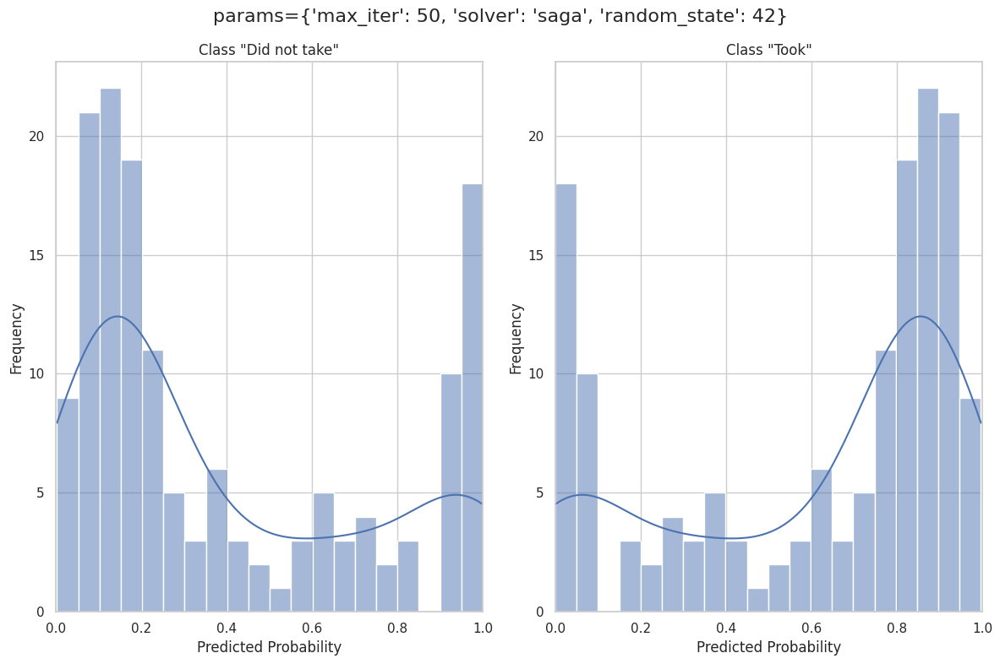

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2]  # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

### Automatically tuning Hyperparameters
with GreadSearchCV

In [ ]:
Y.mean()

0.622

In [ ]:
np.logspace(-1, 1, 10)

array([ 0.1       ,  0.16681005,  0.27825594,  0.46415888,  0.77426368,
        1.29154967,  2.15443469,  3.59381366,  5.9948425 , 10.        ])

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import QuantileTransformer, StandardScaler
from sklearn.linear_model import LogisticRegression
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, accuracy_score, f1_score

model = LogisticRegression(max_iter=500, random_state=42, verbose=3, n_jobs=1)

# Defining the pipeline
pipeline = Pipeline([
    # ('standard_transform', StandardScaler()),
    # ('quantile_transform', QuantileTransformer(output_distribution='uniform')),
    ('model', model)
])
param_grid = {
    'model__C': np.logspace(0, 1, 10),  # Specify 'C' within the 'model' step of the pipeline
    'model__penalty': ['l1', 'l2'],
    'model__class_weight': [None, 'balanced', {0:0.85, 1:1}],
    'model__solver': ['saga', 'liblinear'],
}

scoring = {
    # 'f1_macro': 'f1_macro',
    'f1_w': 'f1_weighted',
    'AUC': 'roc_auc_ovr',
    'accuracy': make_scorer(accuracy_score),
}

# Creating a GridSearchCV object
grid_search = GridSearchCV(
    estimator=pipeline, # a pipeline with feature scaling
    # estimator=model, # normal model
    param_grid=param_grid,
    cv=5,
    scoring=scoring,
    refit='f1_w',  # Setting the metric for re-training the best model
    verbose=3,
    n_jobs=1
)

# Training using GridSearchCV
grid_search.fit(X_train, y_train)

# Best parameters and score
print("\nBest Parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)


Fitting 5 folds for each of 120 candidates, totalling 600 fits
max_iter reached after 0 seconds
[CV 1/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.936) accuracy: (test=0.829) f1_w: (test=0.826) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.878) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.904) accuracy: (test=0.824) f1_w: (test=0.818) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.896) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.879) accuracy: (test=0.806) f1_w: (test=0.805) total time=   0.6s
[LibLinear][CV 1/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.936) accuracy: (test=0.824) f1_w: (test=0.821) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.878) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.900) accuracy: (test=0.829) f1_w: (test=0.824) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.898) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.0s
[LibLinear][CV 5/5] END model__C=1.0, model__cla

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 1/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


convergence after 467 epochs took 1 seconds
[CV 4/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.812) f1_w: (test=0.809) total time=   0.5s
max_iter reached after 0 seconds
[CV 5/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.862) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.4s
[LibLinear][CV 1/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.806) f1_w: (test=0.802) total time=   0.1s
[LibLinear][CV 2/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.869) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.0s
[LibLinear][CV 4/5] 

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.938) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.883) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.911) accuracy: (test=0.841) f1_w: (test=0.841) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.902) accuracy: (test=0.829) f1_w: (test=0.828) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.6s
[LibLinear][CV 1/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.938) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.906) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.901) accuracy: (test=0.829) f1_w: (test=0.828) total time=   0.0s
[LibLinear][CV 5/5] END mode

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


convergence after 469 epochs took 1 seconds
[CV 4/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.6s
max_iter reached after 0 seconds
[CV 5/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.866) accuracy: (test=0.812) f1_w: (test=0.813) total time=   0.6s
[LibLinear][CV 1/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.921) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear][CV 3/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.889) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.1s
[LibLinear][CV 5/5] END model__C=1.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.812) f1_w: (test=0.813) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.936) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.904) accuracy: (test=0.829) f1_w: (test=0.824) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.895) accuracy: (test=0.818) f1_w: (test=0.812) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.879) accuracy: (test=0.818) f1_w: (test=0.816) total time=   0.6s
[LibLinear][CV 1/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.936) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.878) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.900) accuracy: (test=0.829) f1_w: (test=0.824) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.896) accuracy: (test=0.818) f1_w: (test=0.812) total time= 

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


convergence after 477 epochs took 1 seconds
[CV 4/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.874) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.4s
max_iter reached after 0 seconds
[CV 5/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.862) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.4s
[LibLinear][CV 1/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.914) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.867) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.812) f1_

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.935) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.902) accuracy: (test=0.824) f1_w: (test=0.818) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.895) accuracy: (test=0.829) f1_w: (test=0.826) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.806) f1_w: (test=0.805) total time=   0.6s
[LibLinear][CV 1/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.935) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.878) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.898) accuracy: (test=0.829) f1_w: (test=0.824) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.896) accuracy: (test=0.829) f1_w: (test

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.926) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


convergence after 500 epochs took 0 seconds
max_iter reached after 0 seconds
[CV 4/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.812) f1_w: (test=0.809) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.913) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.869) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.824) f1_w: (test=0.819) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.2915496650148839, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.812) f1_w: (test

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.936) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.881) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.909) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.901) accuracy: (test=0.829) f1_w: (test=0.828) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.878) accuracy: (test=0.824) f1_w: (test=0.824) total time=   0.9s
[LibLinear][CV 1/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.937) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.1s
[LibLinear][CV 2/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.904) accuracy: (test=0.841) f1_w: (test=0.841) total time=   0.1s
[LibLinear][CV 4/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.901) accuracy: (test=0.829) f1_w: (test=0.828) total time=   0.0s
[LibLinear][CV 5/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.879) accuracy: (test=0.824) f1_w: (test=0.824) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.841) f1_w: (test=0.841) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.812) f1_w: (test=0.813) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.918) accuracy: (test=0.853) f1_w: (test=0.852) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.889) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.2915496650148839, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (tes

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.934) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.902) accuracy: (test=0.829) f1_w: (test=0.824) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.892) accuracy: (test=0.818) f1_w: (test=0.812) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.812) f1_w: (test=0.810) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.934) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.1s
[LibLinear][CV 2/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.877) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.897) accuracy: (test=0.829) f1_w: (test=0.824) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinea

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.877) accuracy: (test=0.812) f1_w: (test=0.810) total time=   0.0s
max_iter reached after 0 seconds
[CV 1/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.868) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.887) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.874) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.912) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.867) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.2915496650148839, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinea

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.934) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.901) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.891) accuracy: (test=0.829) f1_w: (test=0.826) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.874) accuracy: (test=0.806) f1_w: (test=0.805) total time=   0.7s
[LibLinear][CV 1/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.931) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.877) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.896) accuracy: (test=0.824) f1_w: (test=0.819) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.893) accuracy: (test=0.829) f1_w: (test=0.826) total time=   0.1s
[LibLinear][CV 5/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.873) accuracy: (test=0.806) f1_w: (test=0.805) total time=   0.0s
max_iter reached after 1 seconds
[CV 1/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.812) f1_w: (test=0.809) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.6s
[LibLinear][CV 1/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.912) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.1s
[LibLinear][CV 2/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear][CV 3/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.0s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.0s
[LibLinear][CV 5/5] END model__C=1.6681005372000588, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.855) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.936) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.907) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.898) accuracy: (test=0.835) f1_w: (test=0.834) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.824) f1_w: (test=0.824) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.934) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.1s
[LibLinear][CV 2/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.1s
[LibLinear][CV 3/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.903) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.898) accuracy: (test=0.824) f1_w: (test=0.822) total time=   0.0s
[LibLinear][CV 5/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.877) accuracy: (test=0.824) f1_w: (test=0.824) total time=   0.0s
max_iter reached after 1 seconds
[CV 1/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.931) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.841) f1_w: (test=0.841) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.812) f1_w: (test=0.813) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.847) f1_w: (test=0.846) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.888) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 4/5] END model__C=1.6681005372000588, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (tes

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 1/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.933) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.899) accuracy: (test=0.824) f1_w: (test=0.817) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.889) accuracy: (test=0.818) f1_w: (test=0.812) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.874) accuracy: (test=0.812) f1_w: (test=0.810) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.931) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.0s
[LibLinear][CV 2/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.894) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.1s
[LibLinear][CV 4/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinea

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.812) f1_w: (test=0.810) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.887) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.860) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.911) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.1s
[LibLinear][CV 2/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.867) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear][CV 4/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.1s
[LibLinear][CV 5/5] END model__C=1.6681005372000588, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.855) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.932) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.897) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.829) f1_w: (test=0.826) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.800) f1_w: (test=0.799) total time=   0.6s
[LibLinear][CV 1/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.918) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.1s
[LibLinear][CV 2/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.894) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.888) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.0s
[LibLinear][CV 5/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.862) accuracy: (test=0.806) f1_w: (test=0.805) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.926) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.911) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.882) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.0s
[LibLinear][CV 4/5] END model__C=2.154434690031884, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.81

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.935) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.905) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.895) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.921) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.1s
[LibLinear][CV 2/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.901) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.1s
[LibLinear][CV 4/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.896) accuracy: (test=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.873) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.0s
max_iter reached after 0 seconds
[CV 1/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.931) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.892) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.841) f1_w: (test=0.840) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.888) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 4/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=2.154434690031884, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.932) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.873) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.898) accuracy: (test=0.824) f1_w: (test=0.818) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.818) f1_w: (test=0.812) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.806) f1_w: (test=0.804) total time=   0.8s
[LibLinear][CV 1/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.917) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.1s
[LibLinear][CV 2/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.874) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.893) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear][CV 4/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.887) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 5/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.868) accuracy: (test=0.806) f1_w: (test=0.804) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.859) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.910) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 4/5] END model__C=2.154434690031884, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AU

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.932) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.874) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.892) accuracy: (test=0.824) f1_w: (test=0.818) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.800) f1_w: (test=0.799) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.917) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.1s
[LibLinear][CV 4/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.824) f1_w: (test

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.861) accuracy: (test=0.800) f1_w: (test=0.799) total time=   0.0s
max_iter reached after 1 seconds
[CV 1/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.926) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.4s
[LibLinear][CV 1/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.911) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.869) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.882) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.0s
[LibLinear][CV 4/5] END model__C=2.7825594022071245, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 1/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.935) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.902) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.894) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.872) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.920) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.1s
[LibLinear][CV 2/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.891) accuracy: (test=0.824) f1_w: (test=0.824) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.893) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 5/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.0s
max_iter reached after 0 seconds
[CV 1/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.931) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.7s
[LibLinear][CV 1/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.914) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.1s
[LibLinear][CV 2/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.887) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.1s
[LibLinear][CV 4/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.1s
[LibLinear][CV 5/5] END model__C=2.7825594022071245, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.818) f1_w: (test=0.812) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.916) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.872) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.891) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 5/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.858) accuracy: (test=0.806) f1_w: (test=0.804) total time=   0.0s
max_iter reached after 0 seconds
[CV 1/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.858) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.909) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.0s
[LibLinear][CV 2/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.0s
[LibLinear][CV 3/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 4/5] END model__C=2.7825594022071245, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinea

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 1/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.931) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.874) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.891) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.5s
[LibLinear][CV 1/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.916) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.1s
[LibLinear][CV 2/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.872) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.1s
[LibLinear][CV 5/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.861) accuracy: (test=0.800) f1_w: (test=0.799) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.4s
[LibLinear][CV 1/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.910) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.0s
[LibLinear][CV 2/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.869) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.0s
[LibLinear][CV 4/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=3.5938136638046276, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.856) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.934) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.879) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.899) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.891) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.9s
[LibLinear][CV 1/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.919) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.1s
[LibLinear][CV 2/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.879) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[LibLinear][CV 3/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.887) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.1s
[LibLinear][CV 4/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.891) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 5/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.865) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.4s
[LibLinear][CV 1/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.911) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.0s
[LibLinear][CV 2/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.876) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.887) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 4/5] END model__C=3.5938136638046276, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.884) accuracy: (tes

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 1/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.890) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.882) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.914) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.0s
[LibLinear][CV 2/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.871) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.884) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear][CV 4/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinea

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.859) accuracy: (test=0.812) f1_w: (test=0.810) total time=   0.0s
max_iter reached after 1 seconds
[CV 1/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.858) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.4s
[LibLinear][CV 1/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.909) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.0s
[LibLinear][CV 2/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.0s
[LibLinear][CV 3/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.882) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 4/5] END model__C=3.5938136638046276, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinea

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 1/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.873) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.889) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.883) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.866) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.6s
[LibLinear][CV 1/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.0s
[LibLinear][CV 2/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.1s
[LibLinear][CV 4/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.882) accuracy: (test=0.824) f1_w: (test=0.82

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[LibLinear][CV 5/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.806) f1_w: (test=0.804) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.859) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.7s
[LibLinear][CV 1/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.909) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.1s
[LibLinear][CV 2/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.869) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.1s
[LibLinear][CV 5/5] END model__C=4.641588833612778, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.856) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.0s
max_iter reached after 0 seconds
[CV 1/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.934) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.879) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.896) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.889) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.6s
[LibLinear][CV 1/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.916) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.1s
[LibLinear][CV 2/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear][CV 3/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.887) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.1s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[LibLinear][CV 4/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.889) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 5/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.864) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.866) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.5s
[LibLinear][CV 1/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.908) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.1s
[LibLinear][CV 2/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.887) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 4/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=4.641588833612778, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.889) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.866) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.0s
[LibLinear][CV 2/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.868) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.882) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear][CV 4/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AU

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.859) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.857) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.909) accuracy: (test=0.800) f1_w: (test=0.793) total time=   0.1s
[LibLinear][CV 2/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear][CV 4/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.824) f1_w: (test=0.819) total time=   0.1s
[LibLinear][CV 5/5] END model__C=4.641588833612778, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.855) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.930) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.872) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.881) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.865) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.7s
[LibLinear][CV 1/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.913) accuracy: (test=0.812) f1_w: (test=0.809) total time=   0.1s
[LibLinear][CV 2/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.868) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.882) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.1s
[LibLinear][CV 4/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.824) f1_w: (test=0.821) total time=   0.0s
[LibLinear][CV 5/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.859) accuracy: (test=0.812) f1_w: (test=0.811) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.887) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.859) accuracy: (test=0.788) f1_w: (test=0.787) total time=   0.4s
[LibLinear][CV 1/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.908) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.0s
[LibLinear][CV 2/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.868) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.812) f1_w: (test=0.807) total time=   0.0s
[LibLinear][CV 4/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.824) f1_w: (test=0.82

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=5.994842503189409, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.856) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.933) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.879) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.895) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.6s
[LibLinear][CV 1/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.1s
[LibLinear][CV 2/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.872) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.1s
[LibLinear][CV 4/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.888) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 5/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.864) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.884) accuracy: (test=0.835) f1_w: (test=0.834) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.866) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.5s
[LibLinear][CV 1/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.906) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.1s
[LibLinear][CV 2/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.874) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.0s
[LibLinear][CV 4/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.8

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=5.994842503189409, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.806) f1_w: (test=0.806) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.928) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.879) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.863) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.9s
[LibLinear][CV 1/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.914) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.1s
[LibLinear][CV 2/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.1s
[LibLinear][CV 4/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.879) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.1s
[LibLinear][CV 5/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.859) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.885) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.857) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.4s
[LibLinear][CV 1/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.909) accuracy: (test=0.794) f1_w: (test=0.787) total time=   0.1s
[LibLinear][CV 2/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.865) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.0s
[LibLinear][CV 4/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AU

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=5.994842503189409, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.855) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.872) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.863) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.5s
[LibLinear][CV 1/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.912) accuracy: (test=0.812) f1_w: (test=0.809) total time=   0.1s
[LibLinear][CV 2/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.864) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.881) accuracy: (test=0.806) f1_w: (test=0.802) total time=   0.1s
[LibLinear][CV 4/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.879) accuracy: (test=0.824) f1_w: (test=0.821) total time=   0.1s
[LibLinear][CV 5/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.859) accuracy: (test=0.812) f1_w: (test=0.811) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.859) accuracy: (test=0.788) f1_w: (test=0.787) total time=   0.5s
[LibLinear][CV 1/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.906) accuracy: (test=0.812) f1_w: (test=0.808) total time=   0.1s
[LibLinear][CV 2/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.868) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.802) total time=   0.0s
[LibLinear][CV 4/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.824) f1_w: (test=0.82

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=7.742636826811269, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.856) accuracy: (test=0.800) f1_w: (test=0.799) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.933) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.878) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.894) accuracy: (test=0.841) f1_w: (test=0.841) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.887) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.868) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.5s
[LibLinear][CV 1/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.915) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.1s
[LibLinear][CV 2/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.1s
[LibLinear][CV 4/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.886) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.0s
[LibLinear][CV 5/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.863) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.883) accuracy: (test=0.835) f1_w: (test=0.834) total time=   0.7s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.866) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.7s
[LibLinear][CV 1/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.904) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 2/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.873) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear][CV 3/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.1s
[LibLinear][CV 4/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.1s
[LibLinear][CV 5/5] END model__C=7.742636826811269, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.806) f1_w: (test=0.806) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.927) accuracy: (test=0.806) 

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.870) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.8s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.887) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.878) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.862) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.912) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.0s
[LibLinear][CV 2/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.862) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.878) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.1s
[LibLinear][CV 5/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.858) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.885) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.857) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.908) accuracy: (test=0.794) f1_w: (test=0.787) total time=   0.0s
[LibLinear][CV 2/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.864) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.0s
[LibLinear][CV 4/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AU

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=7.742636826811269, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.855) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.872) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.880) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=saga; AUC: (test=0.862) accuracy: (test=0.794) f1_w: (test=0.793) total time=   0.5s
[LibLinear][CV 1/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.911) accuracy: (test=0.812) f1_w: (test=0.809) total time=   0.1s
[LibLinear][CV 2/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.861) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.802) total time=   0.1s
[LibLinear][CV 4/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.878) accuracy: (test=0.824) f1_w: (test=0.821) total time=   0.0s
[LibLinear][CV 5/5] END model__C=10.0, model__class_weight=None, model__penalty=l1, model__solver=liblinear; AUC: (test=0.859) accuracy: (test=0.812) f1_w: (test=0.811) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.925) accuracy: (test=0.824) f1_w: (test=0.820) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.871) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.888) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.818) f1_w: (test=0.814) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=saga; AUC: (test=0.858) accuracy: (test=0.788) f1_w: (test=0.787) total time=   0.5s
[LibLinear][CV 1/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.906) accuracy: (test=0.806) f1_w: (test=0.802) total time=   0.1s
[LibLinear][CV 2/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.866) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.0s
[LibLinear][CV 3/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.802) total time=   0.0s
[LibLinear][CV 4/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.875) accuracy: (test=0.824) f1_w: (test=0.821) total time=   0.0s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 5/5] END model__C=10.0, model__class_weight=None, model__penalty=l2, model__solver=liblinear; AUC: (test=0.856) accuracy: (test=0.812) f1_w: (test=0.811) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.932) accuracy: (test=0.859) f1_w: (test=0.858) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.878) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.841) f1_w: (test=0.841) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.835) f1_w: (test=0.834) total time=   0.9s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=saga; AUC: (test=0.867) accuracy: (test=0.818) f1_w: (test=0.818) total time=   0.8s
[LibLinear][CV 1/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.914) accuracy: (test=0.853) f1_w: (test=0.853) total time=   0.1s
[LibLinear][CV 2/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.869) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.1s
[LibLinear][CV 4/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.835) f1_w: (test=0.835) total time=   0.1s
[LibLinear][CV 5/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l1, model__solver=liblinear; AUC: (test=0.863) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.1s
max_iter reached after 1 seconds
[CV 1/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.929) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 2/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.877) accuracy: (test=0.859) f1_w: (test=0.857) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 3/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.893) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.4s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 4/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.883) accuracy: (test=0.835) f1_w: (test=0.834) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=saga; AUC: (test=0.865) accuracy: (test=0.812) f1_w: (test=0.812) total time=   0.5s
[LibLinear][CV 1/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.902) accuracy: (test=0.847) f1_w: (test=0.847) total time=   0.1s
[LibLinear][CV 2/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.871) accuracy: (test=0.865) f1_w: (test=0.864) total time=   0.0s
[LibLinear][CV 3/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.885) accuracy: (test=0.829) f1_w: (test=0.830) total time=   0.0s
[LibLinear][CV 4/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.883) accuracy: (test=0.829) f1_w: (test=0.829) total time=   0.0s

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(



[LibLinear][CV 5/5] END model__C=10.0, model__class_weight=balanced, model__penalty=l2, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.806) f1_w: (test=0.806) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.927) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.859) f1_w: (test=0.856) total time=   0.6s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.886) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.878) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 5/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=saga; AUC: (test=0.861) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.6s
[LibLinear][CV 1/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.911) accuracy: (test=0.800) f1_w: (test=0.795) total time=   0.0s
[LibLinear][CV 2/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.860) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.0s
[LibLinear][CV 3/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.880) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 4/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.877) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.1s
[LibLinear][CV 5/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l1, model__solver=liblinear; AUC: (test=0.857) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 0 seconds
[CV 1/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.924) accuracy: (test=0.806) f1_w: (test=0.799) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 2/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.869) accuracy: (test=0.853) f1_w: (test=0.850) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 3/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.885) accuracy: (test=0.812) f1_w: (test=0.806) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 1 seconds
[CV 4/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.876) accuracy: (test=0.818) f1_w: (test=0.813) total time=   0.5s


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


max_iter reached after 0 seconds
[CV 5/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=saga; AUC: (test=0.856) accuracy: (test=0.800) f1_w: (test=0.798) total time=   0.5s
[LibLinear][CV 1/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.908) accuracy: (test=0.800) f1_w: (test=0.794) total time=   0.1s
[LibLinear][CV 2/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.864) accuracy: (test=0.865) f1_w: (test=0.862) total time=   0.1s
[LibLinear]

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


[CV 3/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.879) accuracy: (test=0.806) f1_w: (test=0.801) total time=   0.1s
[LibLinear][CV 4/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.874) accuracy: (test=0.824) f1_w: (test=0.819) total time=   0.1s
[LibLinear][CV 5/5] END model__C=10.0, model__class_weight={0: 0.85, 1: 1}, model__penalty=l2, model__solver=liblinear; AUC: (test=0.854) accuracy: (test=0.806) f1_w: (test=0.803) total time=   0.1s
max_iter reached after 0 seconds

Best Parameters: {'model__C': 1.6681005372000588, 'model__class_weight': 'balanced', 'model__penalty': 'l1', 'model__solver': 'saga'}
Best score: 0.8456031885781128


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


#### Estimating best variant

In [ ]:
best_model = grid_search.best_estimator_
display(best_model)

Pipeline(steps=[('model',
                 LogisticRegression(C=1.6681005372000588,
                                    class_weight='balanced', max_iter=500,
                                    n_jobs=1, penalty='l1', random_state=42,
                                    solver='saga', verbose=3))])

In [ ]:
params = grid_search.best_params_
display(params)

{'model__C': 1.6681005372000588,
 'model__class_weight': 'balanced',
 'model__penalty': 'l1',
 'model__solver': 'saga'}

In [ ]:
from sklearn.linear_model import LogisticRegression
# params = {
#     'max_iter': 10,
#     # 'multi_class': 'ovr',
#     # 'class_weight': 'balanced', # {0: 0.2, 1: 0.8} - manual weighting
#     'penalty': 'l2',
#     'solver': 'liblinear',
#     'random_state': 42,
# }
# best_model.fit(X_train, y_train)

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = best_model.predict_proba(X_test)
Ypred = Yprob > threshold #logistic.predict(X_test)

In [ ]:
Yprob[0:10]

array([[1.34666117e-01, 8.65333883e-01],
       [5.47709217e-02, 9.45229078e-01],
       [6.88224774e-02, 9.31177523e-01],
       [1.00000000e+00, 3.97370774e-14],
       [9.99506540e-01, 4.93459899e-04],
       [8.93293910e-02, 9.10670609e-01],
       [7.89279205e-02, 9.21072079e-01],
       [8.95456765e-03, 9.91045432e-01],
       [9.93993787e-02, 9.00600621e-01],
       [6.76513484e-01, 3.23486516e-01]])

In [ ]:
LABELS = { 0: "Did not take", 1: "Took"}

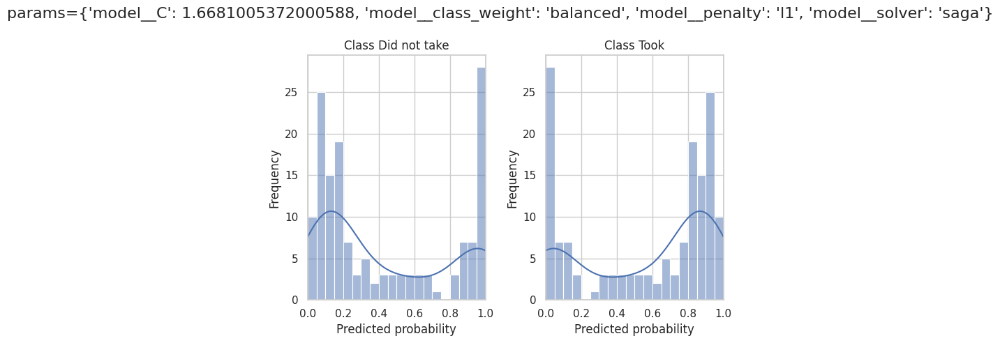

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(7, 5))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class {LABELS[i]}')
    ax.set_xlabel('Predicted probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.metrics import roc_auc_score
# micro ROC AUC
# roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')
roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')

# macro ROC AUC
roc_auc_macro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='macro')

print("Micro ROC AUC:", roc_auc_micro)
print("Macro ROC AUC:", roc_auc_macro)

Micro ROC AUC: 0.768251273344652
Macro ROC AUC: 0.768251273344652


In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=['0', '1']))

              precision    recall  f1-score   support

           0      0.707     0.719     0.713        57
           1      0.826     0.817     0.822        93

    accuracy                          0.780       150
   macro avg      0.766     0.768     0.767       150
weighted avg      0.781     0.780     0.780       150



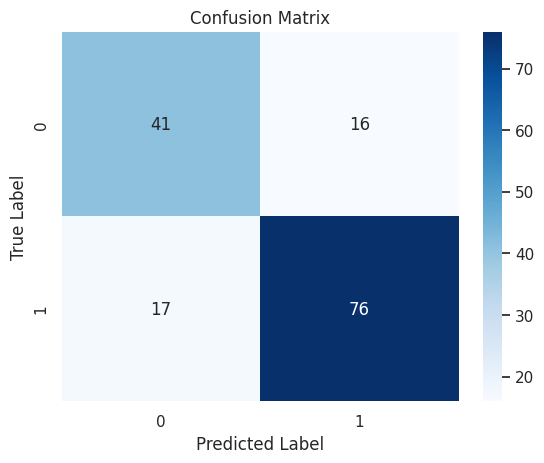

In [ ]:
import seaborn as sns

# Confusion matrix
cm = confusion_matrix(Ytrue, np.argmax(Ypred, axis=1))

# Visualization
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

<ipython-input-3-686b47ceff11>:51: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  per_ok_s = ["%.2f%%" % (per_ok), "100%"][per_ok == 100]


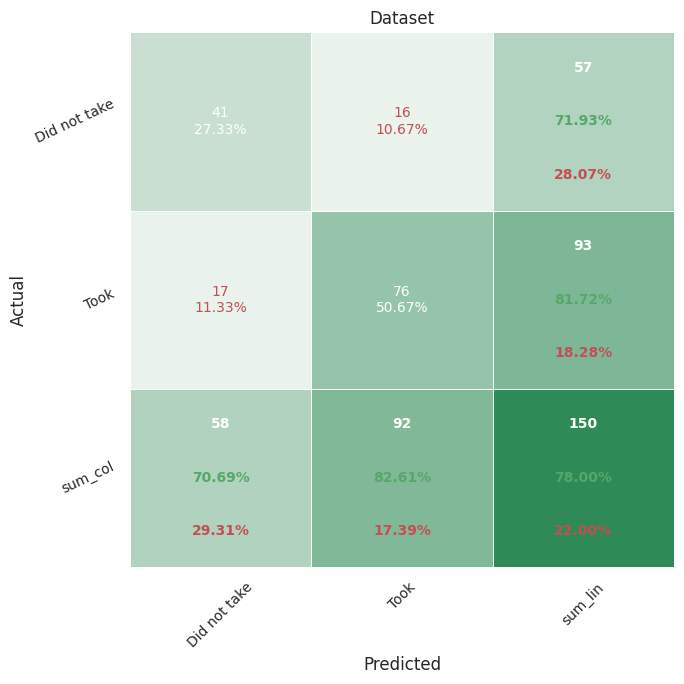

In [ ]:
_ = plot_CM(best_model, X_test, y_test, ['Did not take', 'Took'], figsize=[7,7])

In [ ]:
metrics = plot_multiclass_roc(Ytrue.reshape(-1), Yprob, labels=['Did not take', 'Took'])

## RandomForestClassifier

### Variant 1 - Base (on 'df_1mrg' dataset)

In [ ]:
LABELS = { 1: "Took", 0: "Did not take"}

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Creating a pipeline for the entire process - preprocessing and model training
model = Pipeline(steps=[
    ('classifier', RandomForestClassifier()),
])

In [ ]:
params = {
    'n_estimators': 50,
    'max_features': 'log2',
    'max_depth': 8,
    'min_samples_split': 21,
    'min_samples_leaf': 5,
    'bootstrap': True,
}
model = RandomForestClassifier(verbose=5, n_jobs=1, **params)
model = model.fit(X_train, y_train)

building tree 1 of 50
building tree 2 of 50
building tree 3 of 50
building tree 4 of 50
building tree 5 of 50
building tree 6 of 50
building tree 7 of 50
building tree 8 of 50
building tree 9 of 50
building tree 10 of 50
building tree 11 of 50
building tree 12 of 50
building tree 13 of 50
building tree 14 of 50
building tree 15 of 50
building tree 16 of 50
building tree 17 of 50
building tree 18 of 50
building tree 19 of 50
building tree 20 of 50
building tree 21 of 50
building tree 22 of 50
building tree 23 of 50
building tree 24 of 50
building tree 25 of 50
building tree 26 of 50
building tree 27 of 50
building tree 28 of 50
building tree 29 of 50
building tree 30 of 50
building tree 31 of 50
building tree 32 of 50
building tree 33 of 50
building tree 34 of 50
building tree 35 of 50
building tree 36 of 50
building tree 37 of 50
building tree 38 of 50
building tree 39 of 50
building tree 40 of 50
building tree 41 of 50
building tree 42 of 50
building tree 43 of 50
building tree 44 of 

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = model.predict_proba(X_test)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s


In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

        Took      0.793     0.807     0.800        57
Did not take      0.880     0.871     0.876        93

    accuracy                          0.847       150
   macro avg      0.837     0.839     0.838       150
weighted avg      0.847     0.847     0.847       150



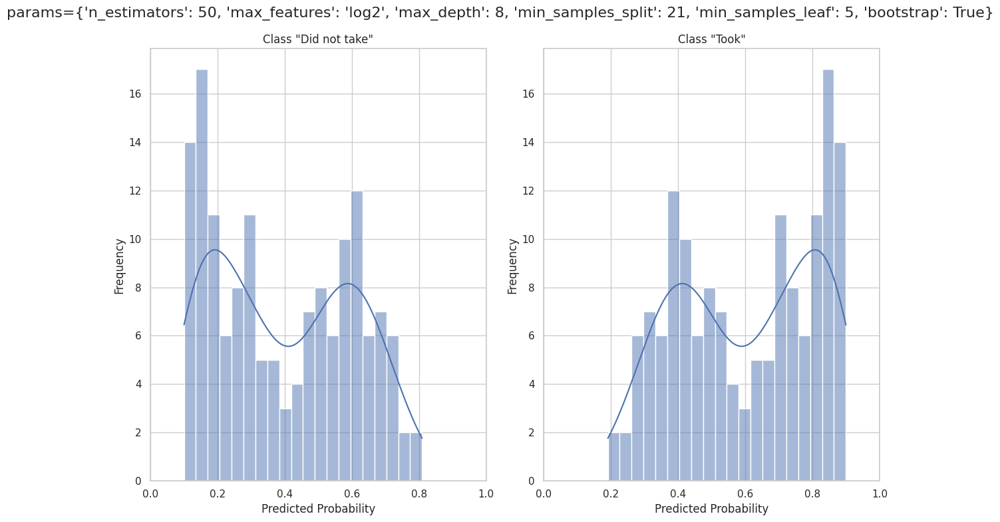

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

### Automatically tuning Hyperparameters
with GreadSearchCV

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import QuantileTransformer, StandardScaler
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, accuracy_score, f1_score
from sklearn.ensemble import RandomForestClassifier


# Creating a pipeline
pipeline = Pipeline([
    # ('standard_transform', StandardScaler()),
    # ('quantile_transform', QuantileTransformer(output_distribution='uniform')),
    ('model', RandomForestClassifier())
])
param_grid = {
    'model__n_estimators': [75, 100, 150],
    'model__max_features': ['sqrt', 'log2'],
    'model__max_depth': [None], #[5, 8, 13],
    'model__min_samples_split': [21, 34, 45],
    'model__min_samples_leaf': [3, 5, 8],
    'model__bootstrap': [True],
    'model__class_weight': [None, 'balanced']
}
scoring = {
    'f1_w': 'f1_weighted',
    'AUC': 'roc_auc',
    'accuracy': make_scorer(accuracy_score),
}

# Creating object GridSearchCV
grid_search = GridSearchCV(
    estimator=pipeline, # a pipeline with feature scaling
    param_grid=param_grid,
    cv=5,
    scoring=scoring,
    refit='f1_w',  # Setting the metric for re-training the best model
    verbose=3,
    n_jobs=1
)

# Training with GridSearchCV
grid_search.fit(X_train, y_train.reshape(-1))

# Best parameters and best score
print("\nBest Parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)

Fitting 5 folds for each of 108 candidates, totalling 540 fits
[CV 1/5] END model__bootstrap=True, model__class_weight=None, model__max_depth=None, model__max_features=sqrt, model__min_samples_leaf=3, model__min_samples_split=21, model__n_estimators=75; AUC: (test=0.963) accuracy: (test=0.906) f1_w: (test=0.906) total time=   0.3s
[CV 2/5] END model__bootstrap=True, model__class_weight=None, model__max_depth=None, model__max_features=sqrt, model__min_samples_leaf=3, model__min_samples_split=21, model__n_estimators=75; AUC: (test=0.958) accuracy: (test=0.888) f1_w: (test=0.886) total time=   0.2s
[CV 3/5] END model__bootstrap=True, model__class_weight=None, model__max_depth=None, model__max_features=sqrt, model__min_samples_leaf=3, model__min_samples_split=21, model__n_estimators=75; AUC: (test=0.957) accuracy: (test=0.924) f1_w: (test=0.924) total time=   0.2s
[CV 4/5] END model__bootstrap=True, model__class_weight=None, model__max_depth=None, model__max_features=sqrt, model__min_sampl

#### Estimating best variant

In [ ]:
best_model = grid_search.best_estimator_
display(best_model)

Pipeline(steps=[('model',
                 RandomForestClassifier(class_weight='balanced',
                                        min_samples_leaf=5,
                                        min_samples_split=34,
                                        n_estimators=150))])

In [ ]:
params = grid_search.best_params_
display(params)

{'model__bootstrap': True,
 'model__class_weight': 'balanced',
 'model__max_depth': None,
 'model__max_features': 'sqrt',
 'model__min_samples_leaf': 5,
 'model__min_samples_split': 34,
 'model__n_estimators': 150}

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = best_model.predict_proba(X_test)
Ypred = Yprob > threshold #logistic.predict(X_test)

In [ ]:
Yprob[0:10]

array([[0.09704322, 0.90295678],
       [0.23642967, 0.76357033],
       [0.14118154, 0.85881846],
       [0.70379966, 0.29620034],
       [0.78285821, 0.21714179],
       [0.09881302, 0.90118698],
       [0.16568152, 0.83431848],
       [0.16547179, 0.83452821],
       [0.10148045, 0.89851955],
       [0.59104285, 0.40895715]])

In [ ]:
LABELS = { 0: "Did not take", 1: "Took"}

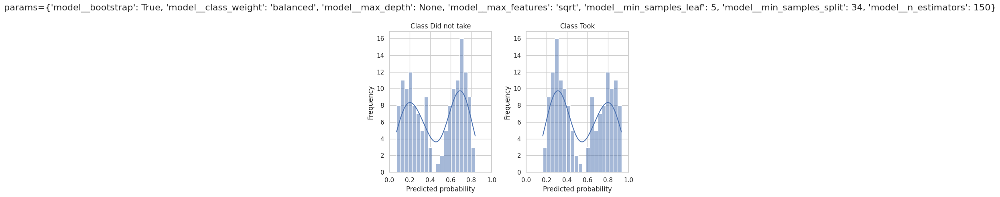

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(7, 5))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class {LABELS[i]}')
    ax.set_xlabel('Predicted probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.metrics import roc_auc_score
# Micro  ROC AUC
# roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')
roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')

# Macro  ROC AUC
roc_auc_macro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='macro')

print("Micro  ROC AUC:", roc_auc_micro)
print("Macro  ROC AUC:", roc_auc_macro)

Micro  ROC AUC: 0.8890775325410298
Macro  ROC AUC: 0.8890775325410298


In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=['0', '1']))

              precision    recall  f1-score   support

           0      0.747     0.982     0.848        57
           1      0.987     0.796     0.881        93

    accuracy                          0.867       150
   macro avg      0.867     0.889     0.865       150
weighted avg      0.895     0.867     0.869       150



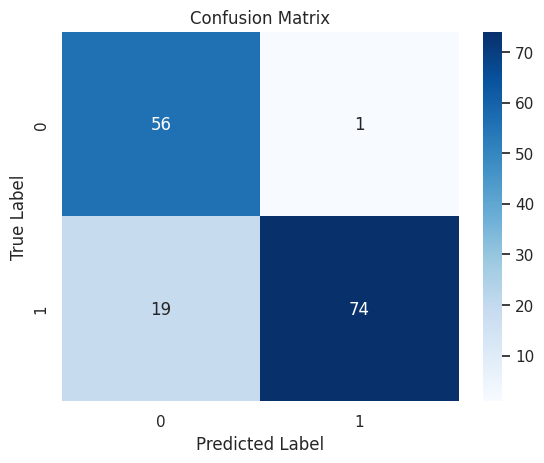

In [ ]:
import seaborn as sns

# Calculating confusion matrix
cm = confusion_matrix(Ytrue, np.argmax(Ypred, axis=1))

# Visualize
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

<ipython-input-3-686b47ceff11>:51: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



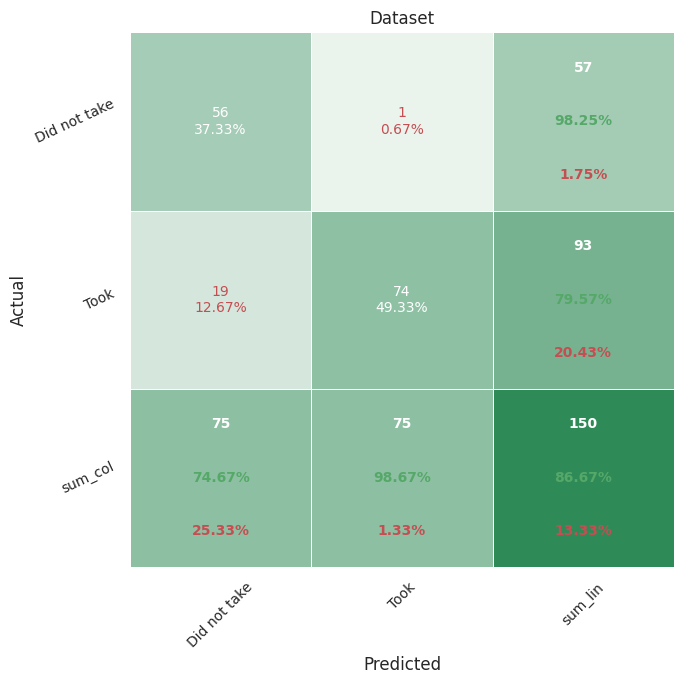

In [ ]:
_ = plot_CM(best_model, X_test, y_test, ['Did not take', 'Took'], figsize=[7,7])

In [ ]:
metrics = plot_multiclass_roc(Ytrue.reshape(-1), Yprob, labels=['Did not take', 'Took'])

## CatBoostClassifier

### Variant 1 - Base (on 'df_1mrg' dataset)

In [ ]:
from catboost import CatBoostClassifier, Pool

# Data preparation
pool_train = Pool(X_train, y_train)
pool_test = Pool(X_test, y_test)

# Model initialization
model = CatBoostClassifier(eval_metric='AUC:hints=skip_train~false', random_seed=42, loss_function='Logloss', verbose=10)

# Defining the parameter grid for the search, including iterations
param_grid = {
    'iterations': [1500],
    'depth': [4, 6, 8],
    'learning_rate': [0.04, 0.1, 0.25],
    'l2_leaf_reg': [0.5, 1, 2, 3, 5, 8]
}

In [ ]:
# Search start
grid_search_result = model.grid_search(param_grid, pool_train)

# REsult analysis
print(grid_search_result['cv_results'])

Streaming output truncated to the last 5000 lines.
1499:	learn: 1.0000000	test: 0.9606427	best: 0.9619693 (32)	total: 14.3s	remaining: 0us

bestTest = 0.9619693396
bestIteration = 32

24:	loss: 0.9619693	best: 0.9671285 (4)	total: 3m 35s	remaining: 4m 10s
0:	learn: 0.9580171	test: 0.9299086	best: 0.9299086 (0)	total: 8.36ms	remaining: 12.5s
10:	learn: 0.9861238	test: 0.9585790	best: 0.9585790 (10)	total: 88.5ms	remaining: 12s
20:	learn: 0.9944440	test: 0.9556309	best: 0.9585790 (10)	total: 174ms	remaining: 12.3s
30:	learn: 0.9974520	test: 0.9565153	best: 0.9585790 (10)	total: 311ms	remaining: 14.7s
40:	learn: 0.9991169	test: 0.9573998	best: 0.9596108 (37)	total: 472ms	remaining: 16.8s
50:	learn: 0.9997608	test: 0.9550413	best: 0.9596108 (37)	total: 632ms	remaining: 17.9s
60:	learn: 0.9999356	test: 0.9551887	best: 0.9596108 (37)	total: 782ms	remaining: 18.4s
70:	learn: 1.0000000	test: 0.9532724	best: 0.9596108 (37)	total: 933ms	remaining: 18.8s
80:	learn: 1.0000000	test: 0.9541568	best:

In [ ]:
grid_search_result['params']

{'depth': 8, 'l2_leaf_reg': 5, 'iterations': 1500, 'learning_rate': 0.1}

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = model.predict_proba(X_test)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

Did not take      0.783     0.947     0.857        57
        Took      0.963     0.839     0.897        93

    accuracy                          0.880       150
   macro avg      0.873     0.893     0.877       150
weighted avg      0.894     0.880     0.882       150



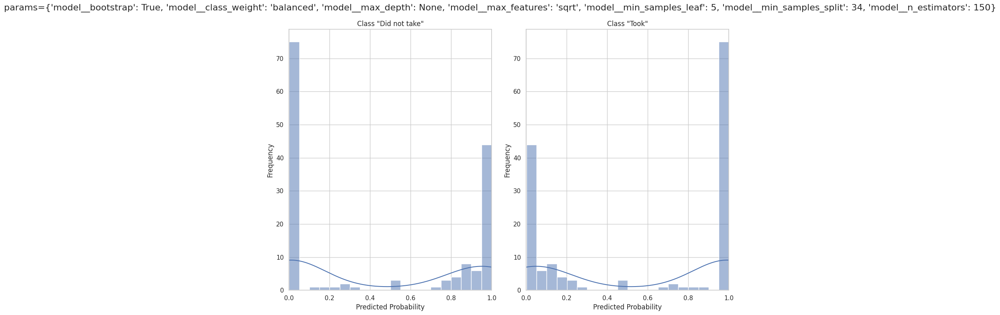

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

# Reducing features count

## PCA

### Transforming the dataset

In [ ]:
print(FEATURES)

['age', 'gender_code', 'aMRG_eop', 'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S', 'tPOS_S', 'gnd_num', 'avg_tr', 'tr_count', 'min_tr', 'max_tr', 'median_tr', 'q1_tr', 'q3_tr', 'kind_1', 'kind_2', 'kind_3', 'kind_4', 'kind_5', 'kind_6', 'kind_7', 'kind_8', 'kind_9', 'kind_10', 'kind_11', 'kind_12', 'kind_13', 'kind_14', 'kind_15', 'kind_16', 'kind_17', 'kind_18', 'kind_19', 'kind_20', 'dir_num_1', 'dir_num_2', 'dir_num_3', 'dir_num_4', 'dir_num_5', 'dir_num_6', 'dir_num_7', 'dir_num_8', 'dir_num_9', 'dir_num_10', 'dir_num_11', 'dir_num_12', 'dir_num_13', 'dir_num_14', 'dir_num_15', 'dir_num_16', 'dir_num_17', 'dir_num_18', 'dir_num_19', 'dir_num_20', 'dir_num_21', 'dir_num_22', 'dir_num_23', 'dir_num_24', 'dir_num_25', 'dir_num_26', 'dir_num_27', 'dir_num_28', 'dir_num_29', 'dir_num_30', 'dir_num_31', 'age_code']


In [ ]:
len(FEATURES)

70

In [ ]:
from sklearn.decomposition import PCA

analyzerPCA = PCA()
analyzerPCA.fit(df_X_train[FEATURES])

PCA()

In [ ]:
import plotly.graph_objects as go

# Obtaining and analyzing the explained variance of each component
explained_var_ratio = analyzerPCA.explained_variance_ratio_

# Cumulative sum of explained variance
cumulative_var_ratio = np.cumsum(explained_var_ratio)

# Building an interactive plot
fig = go.Figure()

fig.add_trace(go.Scatter(y=cumulative_var_ratio, mode='lines+markers', name='Cumulative Variance'))
fig.update_layout(title='Cumulative Explained Variance by PCA Components',
                  xaxis_title='Number of Components',
                  yaxis_title='Cumulative Explained Variance',
                  margin=dict(l=0, r=0, t=30, b=0))
fig.show()

# Choosing the number of components
# For example, determining the number of components to explain 95% variance
TH = 0.98
num_components_reduced = np.where(cumulative_var_ratio >= TH)[0][0] + 1
print(f"Number of components to explain {TH * 100.0}% variance: {num_components_reduced}")

Number of components to explain 98.0% variance: 59


In [ ]:
from sklearn.decomposition import PCA

reducerPCA = PCA(n_components=num_components_reduced)
X_train_reduced = reducerPCA.fit_transform(df_X_train[FEATURES])
X_test_reduced = reducerPCA.transform(df_X_test[FEATURES])
print(X_train_reduced.shape)
print(X_test_reduced.shape)

(850, 59)
(150, 59)


#### Variant 1 - LogisticRegression Base (on 'df_1mrg' dataset)

In [ ]:
LABELS = { 0: "Did not take", 1: "Took"}

In [ ]:
from sklearn.linear_model import LogisticRegression
params = {
    'max_iter': 50,
    # 'class_weight': 'balanced', # {0: 0.2, 1: 3.8} - manual weighting
    # 'penalty': 'l1',
    'solver': 'saga',
    'random_state': 42,
}
logistic = LogisticRegression(verbose=10, n_jobs=1, **params)
logistic = logistic.fit(X_train_reduced, y_train)

max_iter reached after 0 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = logistic.predict_proba(X_test_reduced)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

In [ ]:
from sklearn.metrics import roc_auc_score
# Micro  ROC AUC
# roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')
roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')

# Macro  ROC AUC
roc_auc_macro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='macro')

print("Micro  ROC AUC:", roc_auc_micro)
print("Macro  ROC AUC:", roc_auc_macro)

Micro  ROC AUC: 0.7263723825693266
Macro  ROC AUC: 0.7263723825693266


In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

Did not take      0.700     0.614     0.654        57
        Took      0.780     0.839     0.808        93

    accuracy                          0.753       150
   macro avg      0.740     0.726     0.731       150
weighted avg      0.750     0.753     0.750       150



<ipython-input-3-686b47ceff11>:51: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



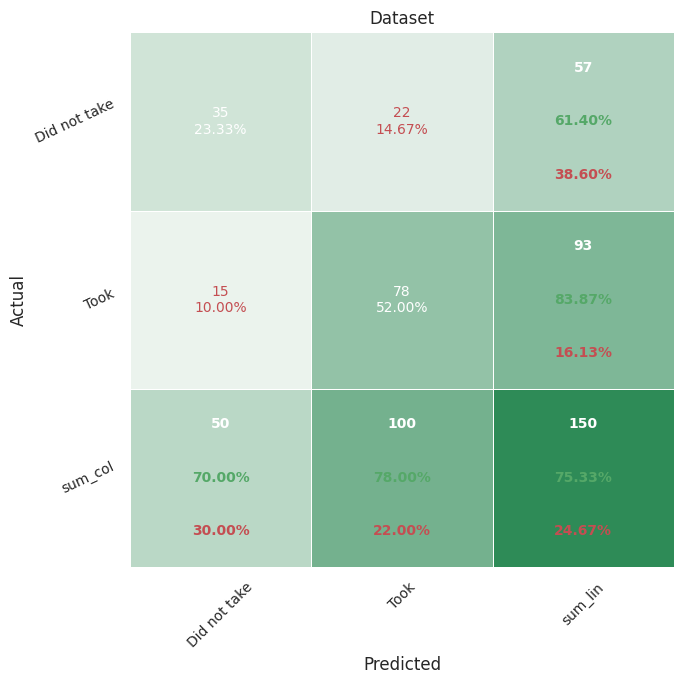

In [ ]:
_ = plot_CM(logistic, X_test_reduced, y_test, ['Did not take', 'Took'], figsize=[7,7])

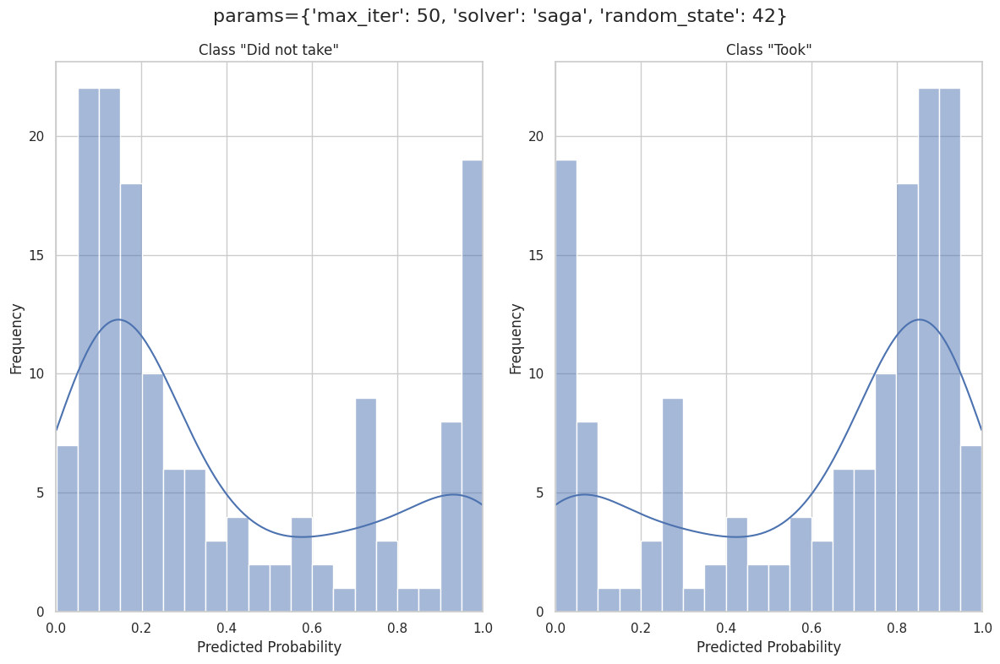

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
metrics = plot_multiclass_roc(Ytrue.reshape(-1), Yprob, labels=['Did not take', 'Took'])

#### Variant 2 - CatBoostClassifier (grid_search)

In [ ]:
from catboost import CatBoostClassifier, Pool

# Data preparation
pool_train = Pool(X_train_reduced, y_train)
pool_test = Pool(X_test_reduced, y_test)

# Model initialization
model = CatBoostClassifier(
    eval_metric='AUC:hints=skip_train~false',
    random_seed=42,
    loss_function='Logloss',
    verbose=10,
    early_stopping_rounds=300
)

# Defining the parameter grid for the search, including iterations
param_grid = {
    'iterations': [1500],
    'depth': [4, 6, 8],
    'learning_rate': [0.04, 0.1, 0.25],
    'l2_leaf_reg': [0.5, 1, 2, 3, 5, 8]
}

In [ ]:
# Search start
grid_search_result = model.grid_search(param_grid, pool_train)

# Result analysis
print(grid_search_result['cv_results'])

0:	learn: 0.7274011	test: 0.7146963	best: 0.7146963 (0)	total: 9.29ms	remaining: 13.9s
10:	learn: 0.8559759	test: 0.7617925	best: 0.7617925 (10)	total: 70.5ms	remaining: 9.54s
20:	learn: 0.8822796	test: 0.7864092	best: 0.7874410 (14)	total: 137ms	remaining: 9.67s
30:	learn: 0.8991408	test: 0.8018868	best: 0.8018868 (30)	total: 211ms	remaining: 10s
40:	learn: 0.9087075	test: 0.8092571	best: 0.8117630 (35)	total: 276ms	remaining: 9.83s
50:	learn: 0.9230345	test: 0.8237028	best: 0.8238502 (49)	total: 338ms	remaining: 9.62s
60:	learn: 0.9333094	test: 0.8253243	best: 0.8256191 (52)	total: 405ms	remaining: 9.56s
70:	learn: 0.9424437	test: 0.8235554	best: 0.8259139 (62)	total: 471ms	remaining: 9.48s
80:	learn: 0.9493612	test: 0.8191333	best: 0.8259139 (62)	total: 540ms	remaining: 9.45s
90:	learn: 0.9547792	test: 0.8191333	best: 0.8259139 (62)	total: 601ms	remaining: 9.31s
100:	learn: 0.9609791	test: 0.8260613	best: 0.8260613 (100)	total: 667ms	remaining: 9.24s
110:	learn: 0.9653761	test: 0.82

In [ ]:
params = grid_search_result['params']
display(params)

{'depth': 4, 'l2_leaf_reg': 5, 'iterations': 1500, 'learning_rate': 0.1}

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = model.predict_proba(X_test_reduced)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

Did not take      0.717     0.579     0.641        57
        Took      0.769     0.860     0.812        93

    accuracy                          0.753       150
   macro avg      0.743     0.720     0.726       150
weighted avg      0.750     0.753     0.747       150



<ipython-input-3-686b47ceff11>:51: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



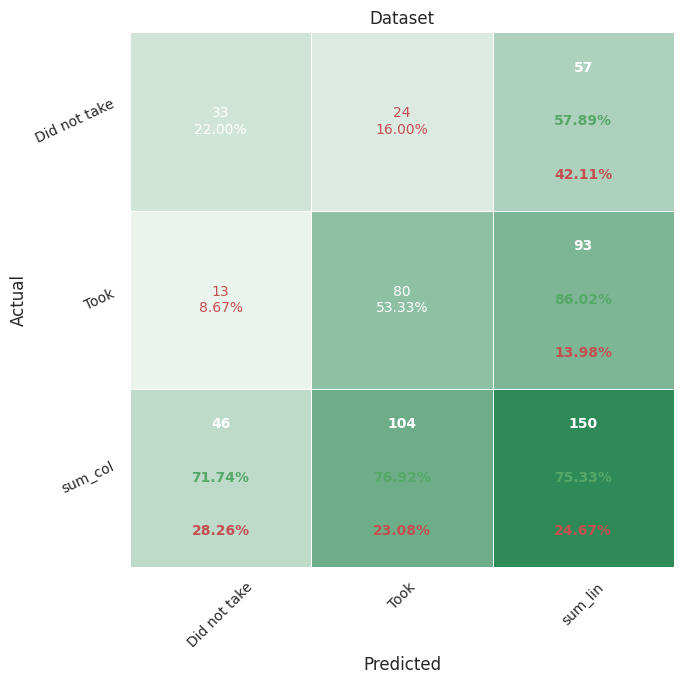

In [ ]:
_ = plot_CM(model, X_test_reduced, y_test, ['Did not take', 'Took'], figsize=[7,7])

In [ ]:
metrics = plot_multiclass_roc(Ytrue.reshape(-1), Yprob, labels=['Did not take', 'Took'])

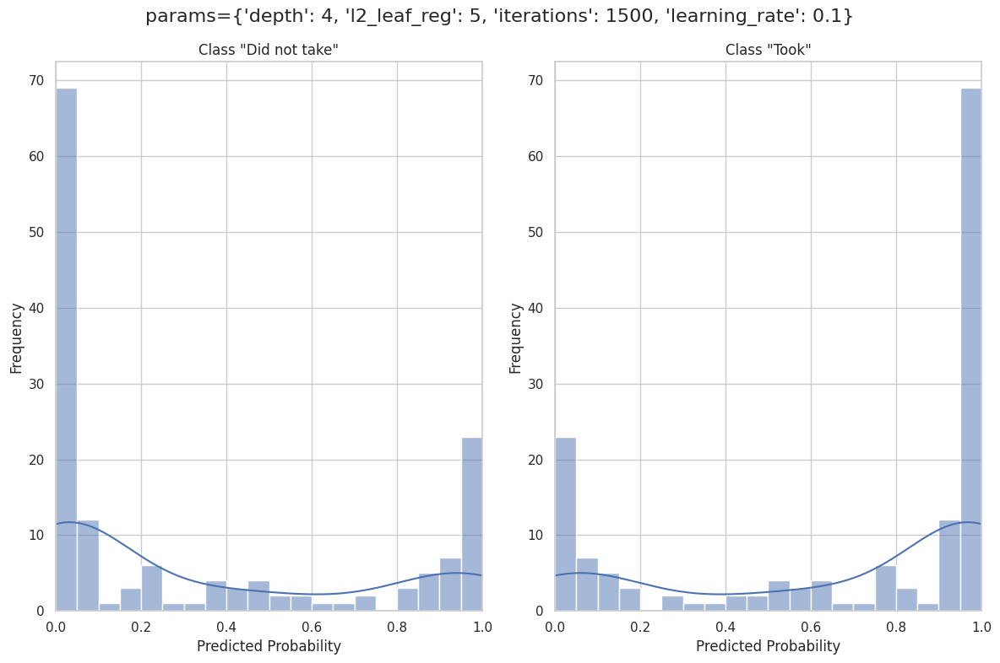

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

## Isomap

In [ ]:
from sklearn.manifold import Isomap
import numpy as np
import plotly.graph_objects as go

NEIGHBORS = 25
# Applying Isomap for different number of components
n_components_list = range(2, len(FEATURES))  # For example, from 2 to 20 components
errors = []

for n in n_components_list:
    isomap = Isomap(n_components=n, n_neighbors=NEIGHBORS)
    isomap.fit(df_X_train[FEATURES])
    errors.append(isomap.reconstruction_error())

# Plotting the reconstruction errors for different number of components
fig = go.Figure(data=go.Scatter(x=list(n_components_list), y=errors, mode='lines+markers'))
fig.update_layout(title=f'Isomap Reconstruction Error as a Function of Number of Components (with {NEIGHBORS} neighbors)',
                  xaxis_title='Number of Components',
                  yaxis_title='Reconstruction Error',
                  margin=dict(l=0, r=0, t=30, b=0))
fig.show()

### Transforming the dataset

In [ ]:
print(FEATURES)

['age', 'gender_code', 'aMRG_eop', 'aCRD_eop', 'pCUR_eop', 'pCRD_eop', 'pSAV_eop', 'pDEP_eop', 'sWork_S', 'tPOS_S', 'gnd_num', 'avg_tr', 'tr_count', 'min_tr', 'max_tr', 'median_tr', 'q1_tr', 'q3_tr', 'kind_1', 'kind_2', 'kind_3', 'kind_4', 'kind_5', 'kind_6', 'kind_7', 'kind_8', 'kind_9', 'kind_10', 'kind_11', 'kind_12', 'kind_13', 'kind_14', 'kind_15', 'kind_16', 'kind_17', 'kind_18', 'kind_19', 'kind_20', 'dir_num_1', 'dir_num_2', 'dir_num_3', 'dir_num_4', 'dir_num_5', 'dir_num_6', 'dir_num_7', 'dir_num_8', 'dir_num_9', 'dir_num_10', 'dir_num_11', 'dir_num_12', 'dir_num_13', 'dir_num_14', 'dir_num_15', 'dir_num_16', 'dir_num_17', 'dir_num_18', 'dir_num_19', 'dir_num_20', 'dir_num_21', 'dir_num_22', 'dir_num_23', 'dir_num_24', 'dir_num_25', 'dir_num_26', 'dir_num_27', 'dir_num_28', 'dir_num_29', 'dir_num_30', 'dir_num_31', 'age_code']


In [ ]:
len(FEATURES)

70

In [ ]:
num_components_reduced = 70
NEIGHBORS = 25

In [ ]:
from sklearn.manifold import Isomap

isomap = Isomap(n_components=num_components_reduced, n_neighbors=NEIGHBORS)
X_train_reduced = isomap.fit_transform(df_X_train[FEATURES])
X_test_reduced = isomap.transform(df_X_test[FEATURES])
print(X_train_reduced.shape)
print(X_test_reduced.shape)

(850, 70)
(150, 70)


#### Variant 1 - LogisticRegression Base (on 'df_1mrg' dataset)

In [ ]:
LABELS = { 0: "Did not take", 1: "Took"}

In [ ]:
from sklearn.linear_model import LogisticRegression
params = {
    'max_iter': 50,
    # 'class_weight': 'balanced', # {0: 0.2, 1: 3.8} - manual weighting
    # 'penalty': 'l1',
    'solver': 'saga',
    'random_state': 42,
}
logistic = LogisticRegression(verbose=10, n_jobs=1, **params)
logistic = logistic.fit(X_train_reduced, y_train)

max_iter reached after 0 seconds


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.1s


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = logistic.predict_proba(X_test_reduced)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

In [ ]:
from sklearn.metrics import roc_auc_score
# Micro  ROC AUC
# roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')
roc_auc_micro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='micro')

# Macro  ROC AUC
roc_auc_macro = roc_auc_score(Ytrue, np.argmax(Yprob, axis=1), average='macro')

print("Micro  ROC AUC:", roc_auc_micro)
print("Macro  ROC AUC:", roc_auc_macro)

Micro  ROC AUC: 0.650820599886814
Macro  ROC AUC: 0.650820599886814


In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

Did not take      0.628     0.474     0.540        57
        Took      0.720     0.828     0.770        93

    accuracy                          0.693       150
   macro avg      0.674     0.651     0.655       150
weighted avg      0.685     0.693     0.683       150



<ipython-input-3-686b47ceff11>:51: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



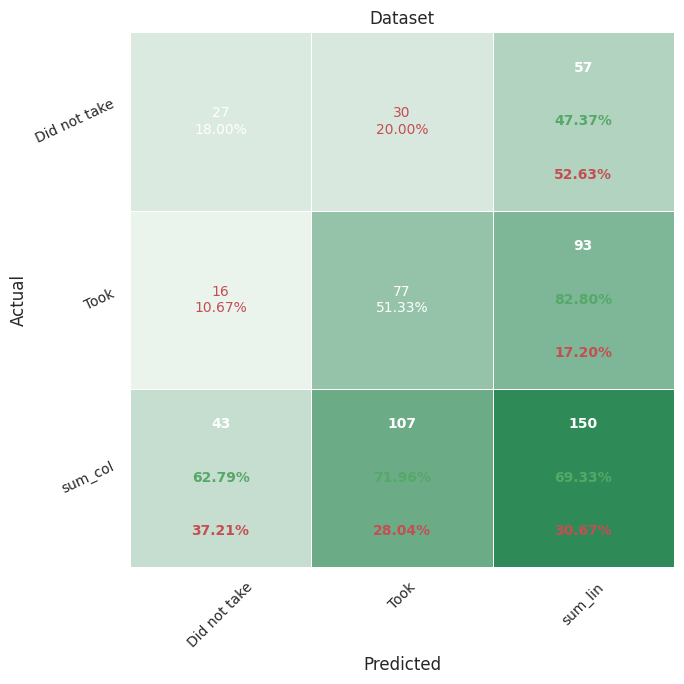

In [ ]:
_ = plot_CM(logistic, X_test_reduced, y_test, ['Did not take', 'Took'], figsize=[7,7])

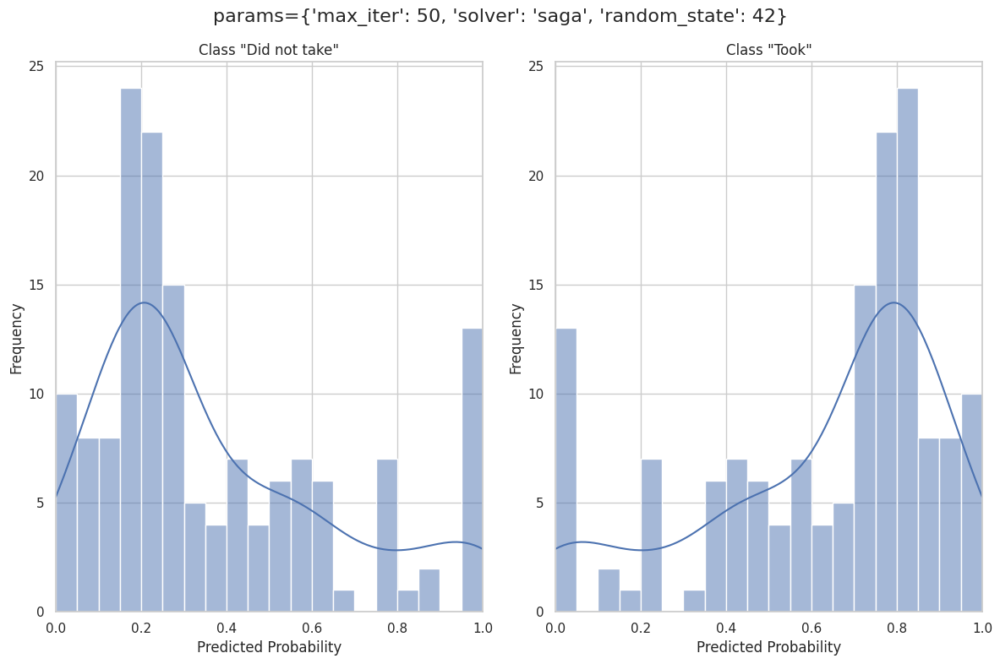

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
metrics = plot_multiclass_roc(Ytrue.reshape(-1), Yprob, labels=['Did not take', 'Took'])

#### Variant 2 - CatBoostClassifier (grid_search)

In [ ]:
from catboost import CatBoostClassifier, Pool

# Data preparation
pool_train = Pool(X_train_reduced, y_train)
pool_test = Pool(X_test_reduced, y_test)

# Model initialization
model = CatBoostClassifier(
    eval_metric='AUC:hints=skip_train~false',
    random_seed=42,
    loss_function='Logloss',
    verbose=10,
    early_stopping_rounds=300
)

# Defining the parameter grid for the search, including iterations
param_grid = {
    'iterations': [1500],
    'depth': [4, 6, 8],
    'learning_rate': [0.04, 0.1, 0.25],
    'l2_leaf_reg': [0.5, 1, 2, 3, 5, 8]
}

In [ ]:
# Search start
grid_search_result = model.grid_search(param_grid, pool_train)

# Results analysis
print(grid_search_result['cv_results'])

0:	learn: 0.6635667	test: 0.5832105	best: 0.5832105 (0)	total: 17.2ms	remaining: 25.7s
10:	learn: 0.8403289	test: 0.6922170	best: 0.6922170 (10)	total: 170ms	remaining: 23s
20:	learn: 0.8642502	test: 0.6673054	best: 0.6936910 (11)	total: 319ms	remaining: 22.5s
30:	learn: 0.8887969	test: 0.6795401	best: 0.6936910 (11)	total: 467ms	remaining: 22.1s
40:	learn: 0.8979312	test: 0.7004717	best: 0.7004717 (40)	total: 603ms	remaining: 21.5s
50:	learn: 0.9109934	test: 0.7119693	best: 0.7119693 (50)	total: 743ms	remaining: 21.1s
60:	learn: 0.9231081	test: 0.7147700	best: 0.7156545 (59)	total: 883ms	remaining: 20.8s
70:	learn: 0.9319296	test: 0.7218455	best: 0.7224351 (68)	total: 1.03s	remaining: 20.8s
80:	learn: 0.9406592	test: 0.7168337	best: 0.7224351 (68)	total: 1.18s	remaining: 20.7s
90:	learn: 0.9495911	test: 0.7234670	best: 0.7237618 (85)	total: 1.32s	remaining: 20.4s
100:	learn: 0.9549356	test: 0.7222877	best: 0.7255307 (98)	total: 1.47s	remaining: 20.4s
110:	learn: 0.9574468	test: 0.7275

In [ ]:
grid_search_result['params']

{'depth': 4, 'l2_leaf_reg': 8, 'iterations': 1500, 'learning_rate': 0.1}

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
threshold = 0.5

Ytrue = y_test
Yprob = model.predict_proba(X_test_reduced)
Ypred = Yprob > threshold #Ypred = logistic.predict(X_test)

In [ ]:
print(classification_report(Ytrue, np.argmax(Ypred, axis=1), digits=3, target_names=list(LABELS.values())))

              precision    recall  f1-score   support

Did not take      0.641     0.439     0.521        57
        Took      0.712     0.849     0.775        93

    accuracy                          0.693       150
   macro avg      0.676     0.644     0.648       150
weighted avg      0.685     0.693     0.678       150



<ipython-input-3-686b47ceff11>:51: DeprecationWarning:

In future, it will be an error for 'np.bool_' scalars to be interpreted as an index



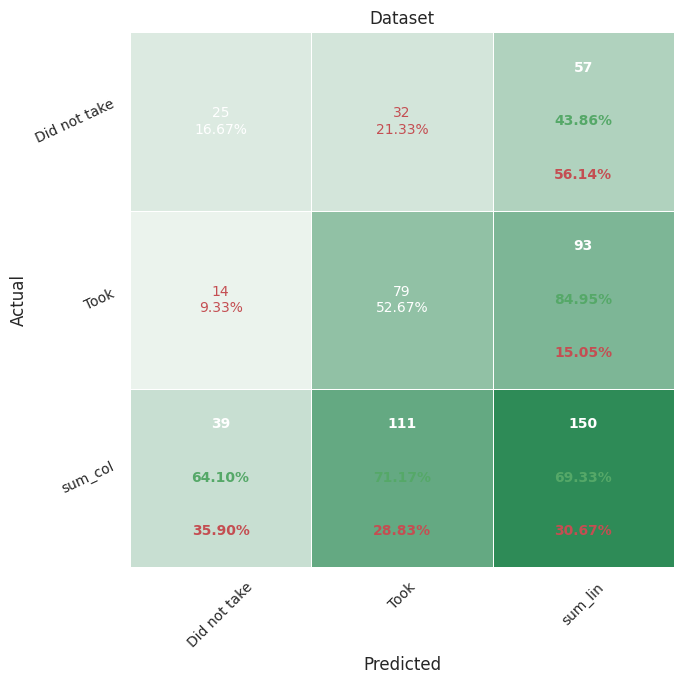

In [ ]:
_ = plot_CM(model, X_test_reduced, y_test, ['Did not take', 'Took'], figsize=[7,7])

In [ ]:
metrics = plot_multiclass_roc(Ytrue.reshape(-1), Yprob, labels=['Did not take', 'Took'])

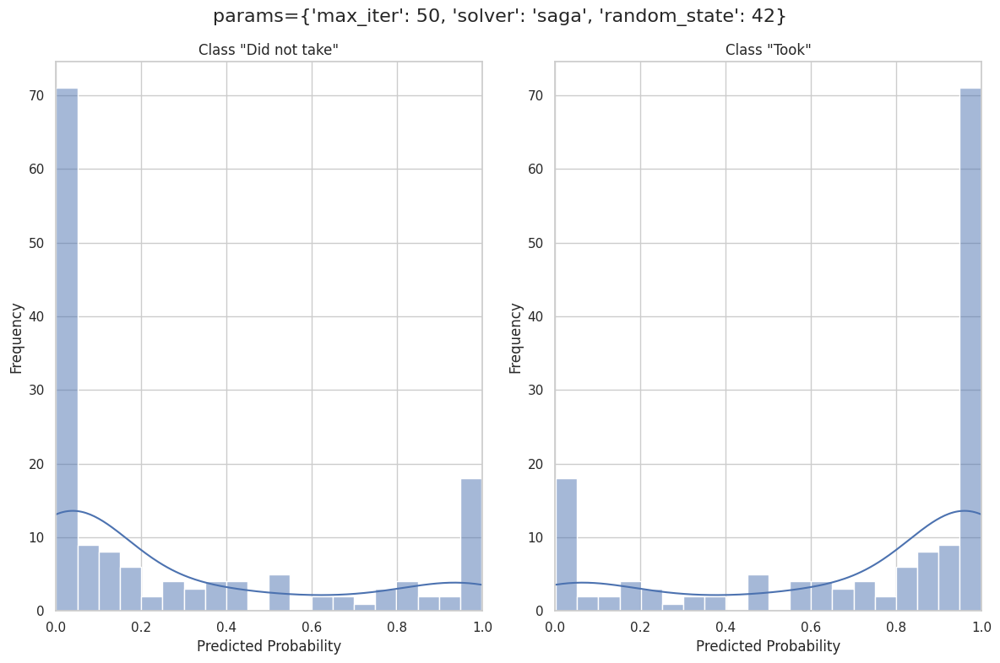

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Creating four different sections in one figure for each class
fig, axs = plt.subplots(1, 2, figsize=(12, 8))
NUM_CLASSES = 2

# Probability distribution for each class
for i in range(NUM_CLASSES):
    ax = axs[i % 2] # [i // 2, i % 2]
    sns.histplot(Yprob[:, i], bins=20, kde=True, ax=ax)
    ax.set_title(f'Class "{LABELS[i]}"')
    ax.set_xlabel('Predicted Probability')
    ax.set_ylabel('Frequency')
    # Setting the scale on the X-axis from 0 to 1
    ax.set_xlim(0, 1)

# Overall title
fig.suptitle(f'params={str(params)}', fontsize=16)
plt.tight_layout()
plt.show()

As we can see here, the best results, with accuracy 0.88 gave CatBoost. Then we tried PCA and Isomap, but both of these decreased accuracy. Seems for our dataset we do not need to decrease quantity of features.